In [1]:
import pandas as pd
import numpy as np
import dask
dask.config.set({'dataframe.query-planning': True})
import dask.dataframe as dd
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots

In [2]:
import os

if not os.path.exists("Figures"):
    os.mkdir("Figures")

In [158]:
ddf = dd.read_parquet("../hpc-datasets/mutations.parquet", engine="pyarrow")
ddf_all_commits = dd.read_parquet("../hpc-datasets/all_commits.parquet", engine="pyarrow")
ddf_commits = dd.read_parquet("../hpc-datasets/commits.parquet", engine="pyarrow")
ddf_repoinfos = dd.read_parquet("../hpc-datasets/repo_infos.parquet", engine="pyarrow")

In [4]:

ddf_repoinfos = dd.read_parquet("../hpc-datasets/repo_infos.parquet", engine="pyarrow")

In [5]:
df_repoinfos = pd.read_parquet("../hpc-datasets/repo_infos.parquet", engine="pyarrow")

In [6]:
df_github = pd.read_csv("../datasets/github_data_07_03_2024.csv",keep_default_na=False)
df_github["repo_id"] = df_github["owner.name"].str.lower() + "_" + df_github["name"].str.lower()
df_github = df_github[~df_github['ignored']]
df_github = df_github.set_index('repo_id')

In [7]:
import yaml
linguist_langs = yaml.safe_load(open("../datasets/linguist/languages.yml", "r"))

In [8]:
linguist_types = set(linguist_langs[x]['type'] for x in linguist_langs)
linguist_types

{'data', 'markup', 'programming', 'prose'}

In [8]:
# ddf_all_commits = ddf_all_commits.set_index("repo_id")
# ddf_commits = ddf_commits.set_index("commit_id") 
# df_repoinfos = df_repoinfos.set_index("repo_id")
# ddf = ddf.set_index("repo_id")

In [154]:
ddf_commits.columns

Index(['commit_time', 'message', 'parents', 'n_added', 'n_deleted', 'n_moved',
       'n_renamed', 'n_struc_changes', 'total_files_per_level',
       'max_file_depth', 'total_files', 'repo_id', 'bucket'],
      dtype='object')

In [166]:
tmp_commits = ddf_commits[ddf_commits['repo_id'] == '10up_wpsnapshots'].compute()

In [186]:
tmp_mutations = ddf[ddf['repo_id'] == '10up_wpsnapshots'].compute()

In [187]:
tmp_commits = tmp_commits.sort_values('commit_time')

In [188]:
tmp_commits

,commit_time,message,parents,n_added,n_deleted,n_moved,n_renamed,n_struc_changes,total_files_per_level,max_file_depth,total_files,repo_id,bucket
commit_id,,,,,,,,,,,,,
da0ebf0761956fd9cc1a5a5c4bb1385e4faa5e0c,1504931008,Initial commit,,22,0,0,0,22,"6,3,7,6",4,22,10up_wpsnapshots,46
897faec2f6288533e9c57e66ca2f45d93ba7272e,1505279856,Rename project,48943cde2f30f4d0c6c986197a88ac3022a4ed9b,0,0,0,5,5,"6,3,7,6",4,22,10up_wpsnapshots,46
5e40831b085486f47dbd54d122359abbea56d238,1537116387,Merge branch 'feature/create',"43f134d5fdecf719eb0c6c8861aa2a99ce0a2220,7e8fc...",5,0,0,0,5,"7,3,9,8",4,27,10up_wpsnapshots,46
7d50727cbe17b2ae0d0216bafdc1fc63a97069c0,1539484070,Refactor for 1.5,4abaa7f329c645e7da5eda70f559466f852d696a,2,2,0,0,4,"7,3,9,8",4,27,10up_wpsnapshots,46
832a7b741a8e8de78f5cd0fed78667733bf37c00,1587069431,Merge branch 'feature/separate-db-files' into ...,"b017a841d15fae96d4696b731a5b2c33f22515a1,ada49...",1,0,0,0,1,"7,3,10,8",4,28,10up_wpsnapshots,46
1a270c4ae144a9f69aaa9976edda934f390309a8,1587070680,Merge branch 'feature/improved-scrub' into dev...,"832a7b741a8e8de78f5cd0fed78667733bf37c00,a235c...",1,0,0,0,1,"7,3,11,8",4,29,10up_wpsnapshots,46
c033cb229b398a129e91f3ddef84145fe58be5ea,1600287877,Merge pull request #72 from eugene-manuilov/fe...,"6aa9c7d65c268b6463d580e8ead14be704fa48ac,8932e...",2,0,0,0,2,"7,4,12,8",4,31,10up_wpsnapshots,46
9a58f54053aec9a0ae5fd49a5b968f9c0860f9c6,1600455335,Merge pull request #74 from 10up/feature/docke...,"aa32b2f07ccff4436167d76edd9b3a4ff9085704,46f7f...",1,0,0,0,1,"7,5,12,8",4,32,10up_wpsnapshots,46
97ac323aded6ce80f590e4797ad840ad4c5d7dd1,1601473402,Merge pull request #75 from 10up/feature/chang...,"a7ed38f407d7c7b2a03bc47b5f7ec733942c4cae,1d503...",1,0,0,0,1,"8,5,12,8",4,33,10up_wpsnapshots,46


In [192]:
    tmp_mutations = tmp_mutations.merge(tmp_commits[['commit_time']], on="commit_id")
    tmp_mutations = tmp_mutations.sort_values('commit_time')
    tmp_mutations = tmp_mutations.drop(columns='commit_time')

In [190]:

    tmp_mutations = tmp_mutations.reset_index()

In [193]:
tmp_mutations

,commit_id,action,old_path,new_path,language,old_file_depth,new_file_depth,repo_id,bucket
0,da0ebf0761956fd9cc1a5a5c4bb1385e4faa5e0c,add,<NA>,.editorconfig,EditorConfig,-1,0,10up_wpsnapshots,708
21,da0ebf0761956fd9cc1a5a5c4bb1385e4faa5e0c,add,<NA>,src/utils.php,PHP,-1,1,10up_wpsnapshots,708
20,da0ebf0761956fd9cc1a5a5c4bb1385e4faa5e0c,add,<NA>,src/classes/WordPressConfig.php,PHP,-1,2,10up_wpsnapshots,708
19,da0ebf0761956fd9cc1a5a5c4bb1385e4faa5e0c,add,<NA>,src/classes/SearchReplace.php,PHP,-1,2,10up_wpsnapshots,708
18,da0ebf0761956fd9cc1a5a5c4bb1385e4faa5e0c,add,<NA>,src/classes/S3.php,PHP,-1,2,10up_wpsnapshots,708
17,da0ebf0761956fd9cc1a5a5c4bb1385e4faa5e0c,add,<NA>,src/classes/ProjectConfig.php,PHP,-1,2,10up_wpsnapshots,708
16,da0ebf0761956fd9cc1a5a5c4bb1385e4faa5e0c,add,<NA>,src/classes/Error.php,PHP,-1,2,10up_wpsnapshots,708
15,da0ebf0761956fd9cc1a5a5c4bb1385e4faa5e0c,add,<NA>,src/classes/DB.php,PHP,-1,2,10up_wpsnapshots,708
14,da0ebf0761956fd9cc1a5a5c4bb1385e4faa5e0c,add,<NA>,src/classes/ConnectionManager.php,PHP,-1,2,10up_wpsnapshots,708
13,da0ebf0761956fd9cc1a5a5c4bb1385e4faa5e0c,add,<NA>,src/classes/Command/Search.php,PHP,-1,3,10up_wpsnapshots,708


In [163]:
def compute_max_depth_diff(df):
    df["max_file_depth_diff"] = (df["max_file_depth"]-df["max_file_depth"].shift(1).fillna(0))
    return df

ddf_commits_2 = ddf_commits.groupby('repo_id').apply(compute_max_depth_diff).compute()

/var/folders/fs/wr2tk6dn7830tfzr5zs3x5_40000gn/T/ipykernel_99645/2901571649.py:5: UserWarning: `meta` is not specified, inferred from partial data. Please provide `meta` if the result is unexpected.
  Before: .apply(func)
  After:  .apply(func, meta={'x': 'f8', 'y': 'f8'}) for dataframe result
  or:     .apply(func, meta=('x', 'f8'))            for series result
  ddf_commits_2 = ddf_commits.groupby('repo_id').apply(compute_max_depth_diff).compute()


In [164]:
ddf_commits_2 = ddf_commits_2.drop('repo_id').reset_index()

commit_time  \
repo_id          commit_id                                               
10up_wpsnapshots 1a270c4ae144a9f69aaa9976edda934f390309a8   1587070680   
                 5e40831b085486f47dbd54d122359abbea56d238   1537116387   
                 7d50727cbe17b2ae0d0216bafdc1fc63a97069c0   1539484070   
                 832a7b741a8e8de78f5cd0fed78667733bf37c00   1587069431   
                 897faec2f6288533e9c57e66ca2f45d93ba7272e   1505279856   
...                                                                ...   
zwcloud_imgui    fe337b22baef847bd1286e0adb7f9575445b4d27   1492133722   
                 fe3e8c0a6c58a5f6ed654e7819a9a21968ecbf2b   1539103265   
                 feebad39ff590eba1e8ccd99c25a2f79a9ac8887   1553789982   
                 ff90033655a12193ba5e3bac37e6fa5a5795148f   1554459179   
                 ffde464fdbc6173b93a4c5ef0fac6cd43798943b   1439224853   

                                                                                                     message  \
repo_id          commit_id                                                                                     
10up_wpsnapshots 1a270c4ae144a9f69aaa9976edda934f390309a8  Merge branch 'feature/improved-scrub' into dev...   
                 5e40831b085486f47dbd54d122359abbea56d238                     Merge branch 'feature/create'
   
                 7d50727cbe17b2ae0d0216bafdc1fc63a97069c0                                  Refactor for 1.5
   
                 832a7b741a8e8de78f5cd0fed78667733bf37c00  Merge branch 'feature/separate-db-files' into ...   
                 897faec2f6288533e9c57e66ca2f45d93ba7272e                                    Rename project
   
...                                                                                                      ...   
zwcloud_imgui    fe337b22baef847bd1286e0adb7f9575445b4d27                                     organize code
   
                 fe3e8c0a6c58a5f6ed654e7819a9a21968ecbf2b  Fixed OS detection for Android.
Upgrade ImageS...   
                 feebad39ff590eba1e8ccd99c25a2f79a9ac8887  extracted parent class *Visual* from Node; clean
   
                 ff90033655a12193ba5e3bac37e6fa5a5795148f           [WIP #23] Adding new abstract: Drawing.
   
                 ffde464fdbc6173b93a4c5ef0fac6cd43798943b  TextBox partially implemented, progress: 50%. ...   

                                                                                                     parents  \
repo_id          commit_id                                                                                     
10up_wpsnapshots 1a270c4ae144a9f69aaa9976edda934f390309a8  832a7b741a8e8de78f5cd0fed78667733bf37c00,a235c...   
                 5e40831b085486f47dbd54d122359abbea56d238  43f134d5fdecf719eb0c6c8861aa2a99ce0a2220,7e8fc...   
                 7d50727cbe17b2ae0d0216bafdc1fc63a97069c0           4abaa7f329c645e7da5eda70f559466f852d696a   
                 832a7b741a8e8de78f5cd0fed78667733bf37c00  b017a841d15fae96d4696b731a5b2c33f22515a1,ada49...   
                 897faec2f6288533e9c57e66ca2f45d93ba7272e           48943cde2f30f4d0c6c986197a88ac3022a4ed9b   
...                                                                                                      ...   
zwcloud_imgui    fe337b22baef847bd1286e0adb7f9575445b4d27           b3a18350a2fe6e2c1edb7481eaf64e1c119a94ba   
                 fe3e8c0a6c58a5f6ed654e7819a9a21968ecbf2b           a5e20bad637c79af1f940b9021ebcbbfe6d5c19b   
                 feebad39ff590eba1e8ccd99c25a2f79a9ac8887           33d7bcfc0a3129cf4009bc76678589f8df45e367   
                 ff90033655a12193ba5e3bac37e6fa5a5795148f           c3bd9df9d1664972d488213463854e2d14c0ae62   
                 ffde464fdbc6173b93a4c5ef0fac6cd43798943b           c9df0861b873e54ca2e00a898d10ed8333482dc9   

                                                           n_added  n_deleted  \
repo_id          commit_id                                                      
10up_wpsnapshots 1a2

In [ ]:
ddf_commits_2.to_parquet("../hpc-datasets/commits_ext_no_sort.parquet", partition_cols='bucket')

In [156]:
del ddf_commits_2

In [9]:
%%time
ddf_repoinfos.groupby('repo_id').count().compute()

CPU times: user 214 ms, sys: 27.8 ms, total: 242 ms
Wall time: 240 ms


,first_commit,last_commit,no_contributors,no_commits,no_struc_changing_commits,max_file_depth
repo_id,,,,,,
0-8-4_miui-auto-tasks,1,1,1,1,1,1
00-evan_shattered-pixel-dungeon,1,1,1,1,1,1
003random_getjs,1,1,1,1,1,1
00imvj00_mqttrs,1,1,1,1,1,1
01-ai_yi,1,1,1,1,1,1
...,...,...,...,...,...,...
zzzprojects_html-agility-pack,1,1,1,1,1,1
zzzprojects_nmemory,1,1,1,1,1,1
zzzprojects_z.extensionmethods,1,1,1,1,1,1


In [10]:
%%time
ddf.groupby('repo_id').count().compute()

CPU times: user 3min 23s, sys: 26 s, total: 3min 49s
Wall time: 24 s


,commit_id,action,old_path,new_path,language,old_file_depth,new_file_depth,bucket
repo_id,,,,,,,,
2881099_freesql.tools,2641,2641,1356,2606,2374,2641,2641,2641
acaudwell_gource,291,291,100,223,185,291,291,291
adafruit_adafruit_gps,146,146,55,125,75,146,146,146
adrielcafe_lyricist,151,151,30,140,130,151,151,151
agens-no_polyglotunity,151,151,32,133,130,151,151,151
...,...,...,...,...,...,...,...,...
vmware-tanzu_sonobuoy,12280,12280,5504,7739,7449,12280,12280,12280
xljiulang_windivertdotnet,144,144,40,115,103,144,144,144
xtrime-ru_telegramapiserver,75,75,18,65,67,75,75,75


In [11]:
%%time
ddf_commits.groupby('repo_id').count().compute()

CPU times: user 3min 40s, sys: 22.6 s, total: 4min 2s
Wall time: 18.2 s


,commit_id,commit_time,message,parents,n_added,n_deleted,n_moved,n_renamed,n_struc_changes,total_files_per_level,max_file_depth,total_files,max_file_depth_diff,bucket
repo_id,,,,,,,,,,,,,,
2881099_freesql.tools,22,22,22,22,22,22,22,22,22,22,22,22,22,22
2bab_seal,21,21,21,21,21,21,21,21,21,21,21,21,21,21
39aldo39_flym-decsync,265,265,265,265,265,265,265,265,265,265,265,265,265,265
51bitquant_51bitquant,26,26,26,26,26,26,26,26,26,26,26,26,26,26
8051enthusiast_at51,11,11,11,11,11,11,11,11,11,11,11,11,11,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
youseries_uflo,20,20,20,20,20,20,20,20,20,20,20,20,20,20
zeeex_xtr-toolbox,14,14,14,14,14,14,14,14,14,14,14,14,14,14
zendea_zendea,8,8,8,8,8,8,8,8,8,8,8,8,8,8


In [12]:
%%time
ddf_all_commits.groupby('repo_id').count().compute()

CPU times: user 1min 1s, sys: 9.93 s, total: 1min 11s
Wall time: 5.39 s


,commit_id,commit_time,bucket
repo_id,,,
2881099_freesql.tools,60,60,60
2bab_seal,62,62,62
39aldo39_flym-decsync,1310,1310,1310
51bitquant_51bitquant,39,39,39
8051enthusiast_at51,67,67,67
...,...,...,...
xljiulang_windivertdotnet,198,198,198
xtrime-ru_telegramapiserver,454,454,454
yiisoft_yii2-jui,2753,2753,2753


In [13]:
%%time
# merged_commits_ddf = ddf_all_commits.join(ddf_commits, rsuffix="_commit", how="left").groupby('repo_id')

CPU times: user 2 µs, sys: 2 µs, total: 4 µs
Wall time: 9.06 µs


In [14]:
%%time
# merged_commits_ddf.count().compute()

CPU times: user 3 µs, sys: 2 µs, total: 5 µs
Wall time: 9.06 µs


# General Statistics

In [15]:
df_repoinfos

,first_commit,last_commit,no_contributors,no_commits,no_struc_changing_commits,max_file_depth
repo_id,,,,,,
mic92_nix-ld,76763ffe0cfa80c51f8f5da3402907a864201fce,bf5aa84a713c31d95b4307e442e966d6c7fd7ae7,9,64,16,3
tdesign-blazor_tdesignblazor,2461a681df89138b77951fe516008e8ea259a92c,e9f4d4e1fb39d4a67796b87bea9b4ad81164bdd8,8,200,123,7
junshengfu_tracking-with-extended-kalman-filter,6613a1ac67fa922ba369be6fc398ccdf7fd48b21,cd97e25809c353f54c66963b034572f3b4867ba8,1,54,12,6
cabinjs_cabin,8770776ffb37ad770af7763afaa7d7db3ecfdbf5,0bfd30afb2a745fa39e40b3eea5928714f1afe38,5,270,17,2
model-bakers_model_bakery,f32e68725caa3fbb36ca47a963ed16ab53fe0b05,c972cbb24f8c1fabfd285112588a72bd282d9014,55,358,36,4
...,...,...,...,...,...,...
conan-io_conan-clion-plugin,82e79a37bcf933d24bd53e92b10647c6678f2d60,ea72f17da293bfb6b09c3ddfbf68bbfb15b88bca,6,390,24,9
executablebooks_jupyter-book,4fc6636c652cebea71556f634c9a37e0740ab26f,aee488a3c071e2ae8167cc8a184aed245df205be,143,792,163,6
project-open-data_db-to-api,707388de7d50ce18be7b68aa68ad7c447a4c3b74,923f5a032aff7597ada9a3d822a626e1445a9b42,5,49,4,4


## Number of contributors

In [16]:
df_repoinfos["no_contributors"].describe()

count    94321.000000
mean        42.809184
std        464.359830
min          1.000000
25%          3.000000
50%          9.000000
75%         26.000000
max      33909.000000
Name: no_contributors, dtype: float64

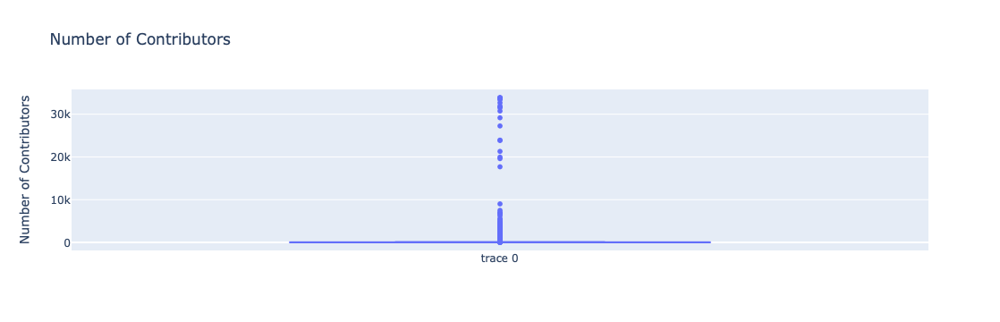

In [17]:
fig = go.Figure()

fig.add_trace(go.Box(y=df_repoinfos["no_contributors"]))

fig.update_layout(title='Number of Contributors',
                  yaxis_title='Number of Contributors')

fig.show()


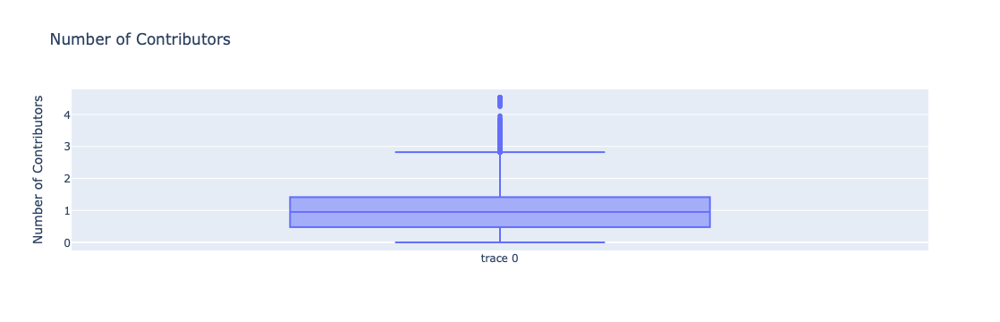

In [18]:
fig = go.Figure()

fig.add_trace(go.Box(y=np.log10(df_repoinfos["no_contributors"])))

fig.update_layout(title='Number of Contributors',
                  yaxis_title='Number of Contributors')

fig.show()


## Nuber of commits

In [19]:
df_repoinfos["no_commits"].describe()

count     94321.000000
mean        715.539403
std        3713.956946
min           1.000000
25%          46.000000
50%         132.000000
75%         410.000000
max      289893.000000
Name: no_commits, dtype: float64

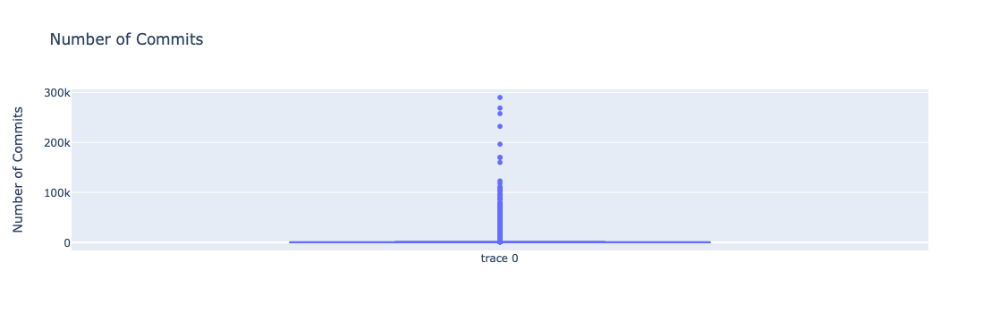

In [20]:
fig = go.Figure()

fig.add_trace(go.Box(y=df_repoinfos["no_commits"]))

fig.update_layout(title='Number of Commits',
                  yaxis_title='Number of Commits')

fig.show()


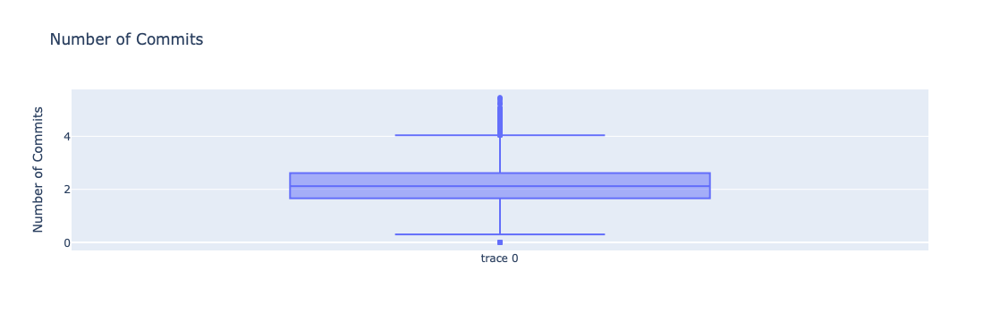

In [21]:
fig = go.Figure()

fig.add_trace(go.Box(y=np.log10(df_repoinfos["no_commits"])))

fig.update_layout(title='Number of Commits',
                  yaxis_title='Number of Commits')

fig.show()


In [22]:
df_repoinfos[df_repoinfos["no_commits"] > 250000]

,first_commit,last_commit,no_contributors,no_commits,no_struc_changing_commits,max_file_depth
repo_id,,,,,,
kiang_pharmacies,6c680c18c408f29292ec620e86fbb574af546248,2d302df804d8bd3aab9b0f958fcc7fd3b28181d5,11,289893,168,10
freebsd_freebsd-src,9002c02abc587664acb357c6879d8ca08664dd0b,6a6ec90681cf30eac2512ab96362a35e259fab62,2099,268800,18977,11
openstack_openstack,1a8546c90100e2e3116b1a74adbeed507ce5e250,d7d4ca6fbd0af095395a72b382e656579e0fa210,3950,257652,225,0


## Max file depth

In [23]:
df_repoinfos["max_file_depth"].describe()

count    94321.000000
mean         5.573966
std          3.520879
min          0.000000
25%          3.000000
50%          5.000000
75%          8.000000
max        122.000000
Name: max_file_depth, dtype: float64

In [24]:
print(df_repoinfos["max_file_depth"].describe().to_latex())

\begin{tabular}{lr}
\toprule
 & max_file_depth \\
\midrule
count & 94321.000000 \\
mean & 5.573966 \\
std & 3.520879 \\
min & 0.000000 \\
25% & 3.000000 \\
50% & 5.000000 \\
75% & 8.000000 \\
max & 122.000000 \\
\bottomrule
\end{tabular}



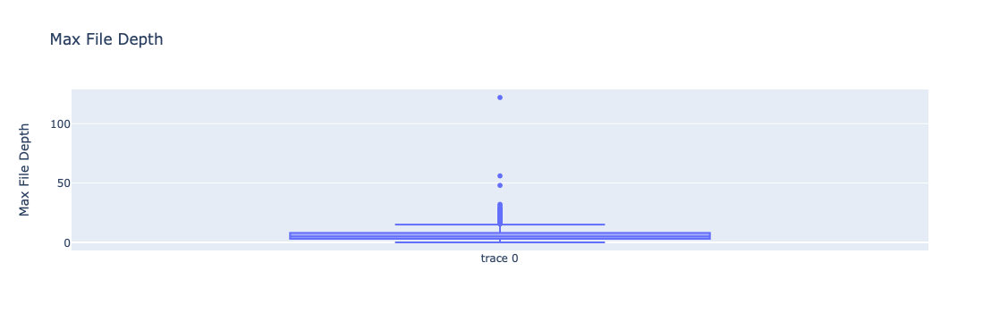

In [25]:
fig = go.Figure()

fig.add_trace(go.Box(y=df_repoinfos["max_file_depth"]))

fig.update_layout(title='Max File Depth',
                  yaxis_title='Max File Depth')

fig.show()
fig.write_image('Figures/max_file_depth.pdf')

In [26]:
ddf_commits["max_file_depth"].describe(percentiles=[0.25,0.5,0.75,0.90,0.95,.99]).compute()

count    1.206058e+07
mean     8.278033e+00
std      3.911850e+00
min      0.000000e+00
25%      5.000000e+00
50%      8.000000e+00
75%      1.100000e+01
90%      1.400000e+01
95%      1.600000e+01
99%      2.000000e+01
max      1.230000e+02
Name: max_file_depth, dtype: float64

In [27]:
def has_max_depth_big_diff(df):
    df = df.sort_values('commit_time')
    df["max_file_depth_diff"] = (df["max_file_depth"]-df["max_file_depth"].shift(1).fillna(0))
    return df

# 14 is 90th percentile of project max
# So first select the projects with "abnormal" large depth
# outlier_projects = ddf_repoinfos[ddf_repoinfos["max_file_depth"] >= 14].compute().index.to_list()

# Select the commits for all repos that are outliers
# outlier_commits = ddf_commits[ddf_commits["repo_id"].isin(outlier_projects)]

# Compute the differences for the max depth
# ddf_commits_with_diff = outlier_commits.groupby("repo_id").apply(has_max_depth_big_diff)
# ddf_commits_with_diff[ddf_commits_with_diff["max_file_depth_diff"].abs() >= 14].to_csv('file_depth_diff_outliers.csv')

# ddf_commits_with_diff = ddf_commits.groupby("repo_id").apply(has_max_depth_big_diff)

In [28]:
ddf_commits['max_file_depth'].describe(percentiles=[0.25,0.5,0.75,0.90,0.95,.99]).compute()

count    1.206058e+07
mean     8.278033e+00
std      3.911850e+00
min      0.000000e+00
25%      5.000000e+00
50%      8.000000e+00
75%      1.100000e+01
90%      1.400000e+01
95%      1.600000e+01
99%      2.000000e+01
max      1.230000e+02
Name: max_file_depth, dtype: float64

In [29]:
ddf_commits['max_file_depth_diff'].describe(percentiles=[0.25,0.5,0.75,0.90,0.95,.99]).compute()

count    1.206058e+07
mean     2.210034e-02
std      4.030660e-01
min     -1.190000e+02
25%      0.000000e+00
50%      0.000000e+00
75%      0.000000e+00
90%      0.000000e+00
95%      0.000000e+00
99%      1.000000e+00
max      5.000000e+01
Name: max_file_depth_diff, dtype: float64

In [30]:
ddf_commits['max_file_depth_diff'].abs().describe(percentiles=[0.25,0.5,0.75,0.90,0.95,.99]).compute()

count    1.206058e+07
mean     4.211049e-02
std      4.014689e-01
min      0.000000e+00
25%      0.000000e+00
50%      0.000000e+00
75%      0.000000e+00
90%      0.000000e+00
95%      0.000000e+00
99%      1.000000e+00
max      1.190000e+02
Name: max_file_depth_diff, dtype: float64

In [31]:
temp_data = ddf_commits[ddf_commits["max_file_depth_diff"].abs() > 0]

In [32]:
temp_data["max_file_depth_diff"].abs().describe(percentiles=[0.25,0.5,0.75,0.90,0.95,.99]).compute()

count    256286.000000
mean          1.981681
std           1.934234
min           1.000000
25%           1.000000
50%           1.000000
75%           2.000000
90%           4.000000
95%           7.000000
99%          11.000000
max         119.000000
Name: max_file_depth_diff, dtype: float64

In [33]:
temp_data["max_file_depth_diff"].abs().describe(percentiles=[0.25,0.5,0.75,0.90,0.95,.99,.999,.9999]).compute()

count     256286.000000
mean           1.981681
std            1.934234
min            1.000000
25%            1.000000
50%            1.000000
75%            2.000000
90%            4.000000
95%            7.000000
99%           11.000000
99.9%         14.288000
99.99%        22.885100
max          119.000000
Name: max_file_depth_diff, dtype: float64

In [34]:
temp_data_2 = temp_data[temp_data["max_file_depth_diff"].abs() >= 11].compute()
temp_data_2.to_csv('temp_data_2_3.csv')
temp_data_2

,repo_id,commit_id,commit_time,message,parents,n_added,n_deleted,n_moved,n_renamed,n_struc_changes,total_files_per_level,max_file_depth,total_files,max_file_depth_diff,bucket
1002,gliderlabs_registrator,e2677212c2d851e64581286e4c8e99ec9ba8fead,1424281983,"overhaul of build/release system, modeled afte...",ee8720d50ab6677ca6e4932cfc1e03a040cbdbd6,4,215,0,0,219,"15,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0",1,15,-16.0,0
1375,migomiddle_xms,329d965cf88508daa951d1a925a2bc8ee95c556e,1574228833,init,75cf034faac76dbfe83b0951cc71616a8f35ceb8,16706,0,0,0,16706,"3,0,59,1233,1262,978,8062,962,1072,951,627,267...",16,16708,15.0,0
4955,qist_tvbox,fcbdcfd1cb2fe73932cec1eb01f1e180c258bdf3,1661302519,"更新 '{""key"":""csp_XYQBiu_短视频"",""name"":""分享短视频(YXQ)...",1fe2b7b6242c95ef0f07f88ed2e32f552fd30448,0,0,2,0,2,"14,9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1",17,24,15.0,0
4956,qist_tvbox,d9cb84f70c851330cbb942111c2c2e4e966596bc,1661302879,"删除 '{""key"":""csp_XYQBiu_短视频"",""name"":""分享短视频(YXQ)...",fcbdcfd1cb2fe73932cec1eb01f1e180c258bdf3,0,2,0,0,2,"14,9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0",2,23,-15.0,0
6640,ahmadaghazadeh_codeeditor,0b4212f88fcc6bfcb42d2b278728fafc58c44c14,1538309772,First Commit,74690e8a2aa4d3e569ad662a5c4ccaf0897eb6da,319,0,0,0,319,"8,10,3,2,0,252,0,0,5,15,18,9",12,322,11.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26454,skydoves_compose-stable-marker,22cc19bfcda357237a68a3c1799463e4d446e5a7,1690264796,Initial commit,9be97f227a195a6f9967afedbac9d9545ac797c0,55,0,0,0,55,"11,13,4,1,0,19,0,4,0,0,1,3",12,56,11.0,76
46282,saysky_forestblog,5bfffa0d01927642ba173f06b8f4ff5632288fa9,1507543150,第一次更新,d9c1c8000362e4278d6e0794cda7e0457102ad69,1,807,0,0,808,"2,0,0,0,0,0,0,0,0,0,0,0,0",1,2,-12.0,76
46283,saysky_forestblog,b0ffed868a3dfd165760344c2892a37663e1b621,1507543225,第一次更新,f93e1de434a48fe60b88c627404528934d889ccd,898,0,0,0,898,"3,3,8,130,5,10,4,16,103,515,96,0,7",13,900,12.0,76
46286,saysky_forestblog,1fb73b2663f8f42132d3bfdc4f2de2f301442690,1507608727,第一次更新,f8c9080a0483e34990ec8aa070d0484fddb6255f,1,809,0,0,810,"2,0,0,0,0,0,0,0,0,0,0,0,0",1,2,-12.0,76


In [35]:
# temp_data_2.merge(df_github[['lang']], on="repo_id")

In [36]:
2675

2675

In [37]:
ddf_commits[ddf_commits["repo_id"] == "gisto_gisto"].compute().to_csv('gusto_commits.csv')

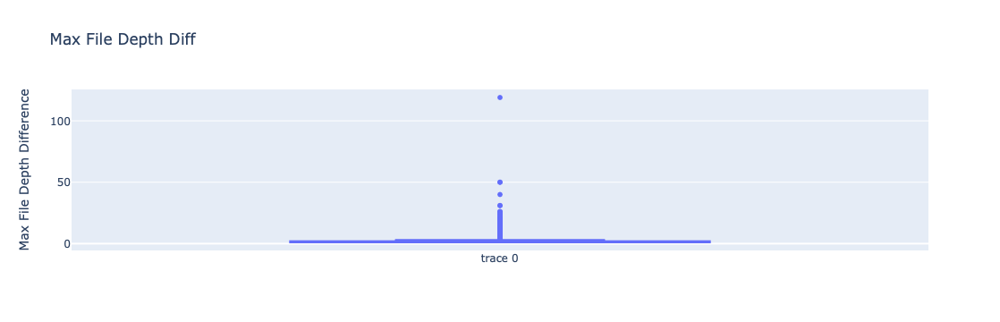

In [38]:
# Create a box plot of the filtered data
fig = go.Figure()

fig.add_trace(go.Box(y=temp_data["max_file_depth_diff"].abs()))

# Update layout with titles and axis labels
fig.update_layout(
    title='Max File Depth Diff',
    yaxis_title='Max File Depth Difference'
)

# Show the plot
fig.show()
# fig.write_image('Figures/.pdf')

In [39]:
temp_data["max_file_depth_diff"].abs().describe(percentiles=[0.25,0.5,0.75,0.90,0.95,.99,.999])

<dask_expr.expr.Series: expr=(Abs(frame=(Filter(frame=ReadParquetFSSpec(80d4d56), predicate=Abs(frame=ReadParquetFSSpec(80d4d56)['max_file_depth_diff']) > 0))['max_file_depth_diff'])).describenumeric(split_every=False, percentiles=[0.25, 0.5, 0.75, 0.9, 0.95, 0.99, 0.999])>

In [40]:
# outlier_data_2 = ddf[~((ddf['new_file_depth'] >= lower_bound) & (ddf['new_file_depth'] <= upper_bound))].compute()
# outlier_data_2.sort_values('new_file_depth', ascending=False).drop_duplicates(subset='commit_id')

In [41]:
# outlier_data.sort_values("max_file_depth", ascending=False)

In [42]:
depth_occurences = df_repoinfos.groupby("max_file_depth")["first_commit"].count()

In [43]:
import scipy.stats as stats

mean = 3.10
std_dev = 2.05

# Generate x values for the distribution curve
x = np.linspace(0, np.max(depth_occurences), 100)
# Calculate corresponding y values from the normal distribution
y = len(depth_occurences)*stats.norm.pdf(x, loc=mean, scale=std_dev)

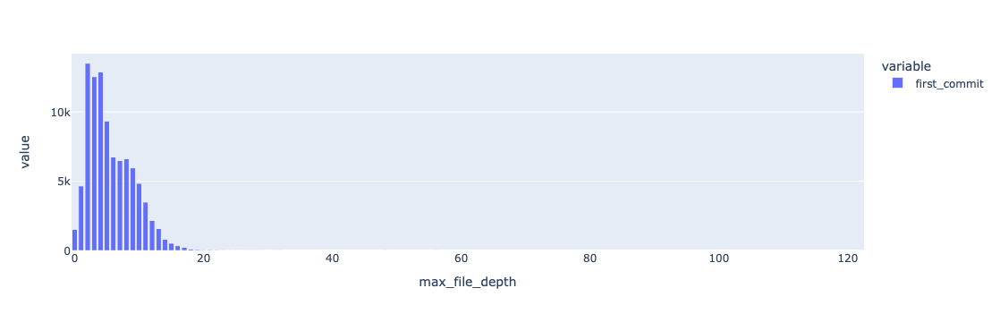

In [44]:
fig = px.bar(depth_occurences)
fig.show()# Add the distribution curve as a line plot

In [45]:
# Calculate counts of occurrences for each file depth level
counts = df_repoinfos['max_file_depth'].value_counts()

# Perform the Kolmogorov-Smirnov test on the counts data
mean_counts = counts.mean()
std_dev_counts = counts.std()

statistic, p_value = stats.kstest(counts, 'norm', args=(mean_counts, std_dev_counts))

# Interpret the test result
alpha = 0.05  # Significance level
print(f"Kolmogorov-Smirnov Test on Counts:")
print(f"Test Statistic: {statistic:.4f}")
print(f"P-value: {p_value:.4f}")

if p_value < alpha:
    print("The counts do not follow a normal distribution.")
else:
    print("The counts follow a normal distribution.")

Kolmogorov-Smirnov Test on Counts:
Test Statistic: 0.2780
P-value: 0.0070
The counts do not follow a normal distribution.


In [46]:
df_repoinfos[df_repoinfos["max_file_depth"] > 40]

,first_commit,last_commit,no_contributors,no_commits,no_struc_changing_commits,max_file_depth
repo_id,,,,,,
kgn_kgnautolayout,aa5154002620e307d6463eab490c66e00eee99c7,1ad272d312dcfd3b18b15fb90c53fc21a6a8d819,4,137,34,122
napalm-automation_napalm,8472e7d97cafb0e316310c5ca08da0d3dad47b17,1858e725d582be1b11c056a62a7768c3293d6fa3,216,868,228,56
packtpublishing_swift-3-functional-programming,f4e9aa2c55788d36e32a6c6602baa649b91eaa26,94ac3a2ba26303fd025828e49d261ce0eaf2cafb,5,44,12,48


In [134]:
df_repoinfos["max_file_depth"].quantile(0.99)

15.0

In [146]:
# How many projects are above Q3
repos_above_99 = ddf_repoinfos[ddf_repoinfos["max_file_depth"] >= ddf_repoinfos["max_file_depth"].quantile(0.99)].compute()

In [150]:
repos_above_99["lang"].value_counts()

lang
Java          553
Go            206
Kotlin        168
C_C++         103
JavaScript     96
PHP            80
Swift          47
C#             35
Python         33
Rust            7
Name: count, dtype: int64

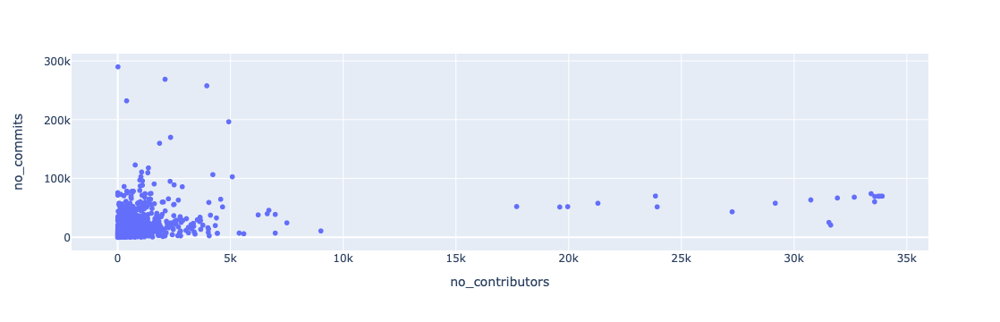

In [49]:
fig = px.scatter(df_repoinfos, x="no_contributors", y="no_commits")
fig.show()


In [50]:
# ddf_all_commits = ddf_all_commits.set_index("commit_id")
# df_repoinfos_first = ddf_repoinfos.merge(ddf_all_commits, left_on="first_commit", right_index=True, how="left")
# df_repoinfos_last = ddf_repoinfos.merge(ddf_all_commits, left_on="last_commit", right_index=True, how="left")

In [51]:
# df_repoinfos_first.compute()

# Differentiate by Programming Language

In [145]:
ddf_repoinfos = ddf_repoinfos.merge(df_github[['lang']])

In [143]:
ddf_repoinfos.head()

KeyboardInterrupt: 

In [37]:
ddf_repoinfos[ddf_repoinfos["lang"] == ''].compute()

,first_commit,last_commit,no_contributors,no_commits,no_struc_changing_commits,max_file_depth,lang
repo_id,,,,,,,


In [55]:
df_github.loc['duo001_evil.js']

name                                                 evil.js
url                        https://github.com/duo001/evil.js
clone_url              https://github.com/duo001/evil.js.git
default_branch                                        master
stargazers_count                                        1634
owner.name                                            duo001
owner.type                                              User
description                                 Use with caution
language                                                    
topics                                                      
size                                                     217
archived                                               False
created_at                         2021-04-09 07:45:31+00:00
pushed_at                          2022-08-19 03:47:09+00:00
ignored                                                False
lang                                              JavaScript
ignored_name            

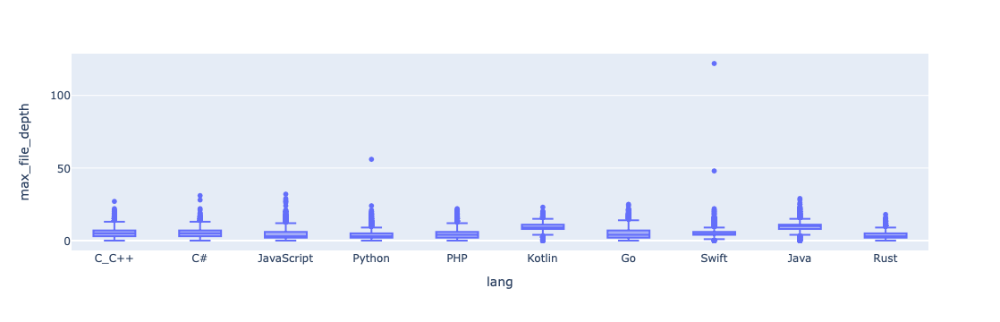

In [56]:
fig = px.box(ddf_repoinfos.compute(), x='lang', y='max_file_depth')
fig.show()

['C_C++' 'C#' 'JavaScript' 'Python' 'PHP' 'Kotlin' 'Go' 'Swift' 'Java'
 'Rust']


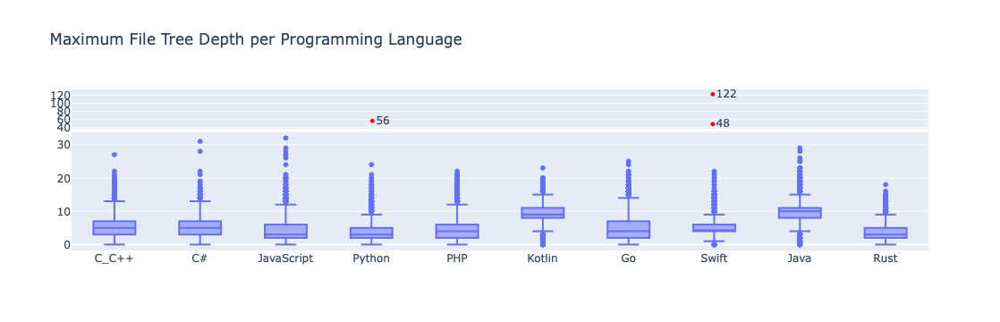

In [57]:
# Filtered version
tmp_box_data = ddf_repoinfos.compute()
thresh = 40

box_data = tmp_box_data[tmp_box_data['max_file_depth'] <= thresh]
outlier_data = tmp_box_data[tmp_box_data['max_file_depth'] > thresh]

categories = box_data['lang'].unique()
print (categories)

boxplot_trace = go.Box(x=box_data['lang'], y=box_data['max_file_depth'], name='Data')

outlier_traces = []
for lang in categories:
    lang_outlier_data = outlier_data[outlier_data['lang'] == lang]
    if not lang_outlier_data.empty:
        trace = go.Scatter(
            x=[lang] * len(lang_outlier_data),
            y=lang_outlier_data['max_file_depth'],
            mode='markers+text',
            name=lang,
            marker=dict(color='red', size=5),
            text=lang_outlier_data['max_file_depth'],
            textposition='middle right',
        )
        outlier_traces.append(trace)
    else:
        # Create an empty trace with category name
        trace = go.Scatter(
            x=[lang],
            y=[None],  # Provide empty y-values
            mode='markers',
            name=lang,
            marker=dict(color='red', size=0)  # Set size to 0 for invisible markers
        )
        outlier_traces.append(trace)

# Create the figure
fig = make_subplots(rows=2, cols=1, vertical_spacing = 0.02, row_heights=[0.25, 0.75])
fig.add_trace(boxplot_trace, row=2, col=1)

# fig.add_trace(outliers_trace, row=1, col=1)
# Add outlier scatter traces to the figure
for trace in outlier_traces:
    fig.add_trace(trace, row=1, col=1)

# Update layout for clarity (optional)
fig.update_layout(title='Maximum File Tree Depth per Programming Language', yaxis_title='Value')

# Hide the legend
fig.update_layout(showlegend=False, height=500)

# Hide axis labels in the upper subplot
fig.update_xaxes(showticklabels=False, showgrid=False, row=1, col=1)
fig.update_yaxes(title_text='', row=1, col=1)

# Synchronize y-axis ranges between subplots
# fig.update_yaxes(range=[35, outlier_data['max_file_depth'].max()+15], row=1, col=1)
# fig.update_yaxes(range=[box_data['max_file_depth'].min()-5, 35], row=2, col=1)

# Show the plot
fig.show()
fig.write_image('Figures/max_file_depth_per_lang.pdf')

In [9]:
pcs_in_data = ddf_repoinfos.compute().groupby('lang')["max_file_depth"].describe(percentiles=[0.25,0.5,0.75,0.9,0.95,0.99])

In [10]:
pcs_in_data

,count,mean,std,min,25%,50%,75%,90%,95%,99%,max
lang,,,,,,,,,,,
C#,9297.0,5.184361,2.617547,0.0,3.0,5.0,7.0,9.0,10.0,13.00,31.0
C_C++,9587.0,5.194951,3.337767,0.0,3.0,5.0,7.0,10.0,12.0,15.00,27.0
Go,9677.0,4.913196,3.730414,0.0,2.0,4.0,7.0,10.0,12.0,17.00,25.0
Java,9266.0,9.757716,2.965698,0.0,8.0,10.0,11.0,13.0,15.0,18.00,29.0
JavaScript,9424.0,4.276316,3.045909,0.0,2.0,3.0,6.0,8.0,10.0,15.00,32.0
Kotlin,9036.0,9.433710,2.236620,0.0,8.0,9.0,11.0,12.0,13.0,15.65,23.0
PHP,9623.0,4.554297,2.973160,0.0,2.0,4.0,6.0,9.0,11.0,14.00,22.0
Python,9525.0,3.917690,2.640060,0.0,2.0,3.0,5.0,7.0,9.0,12.00,56.0
Rust,9699.0,3.699247,2.152461,0.0,2.0,3.0,5.0,6.0,8.0,11.00,18.0


In [60]:
pcs_in_data['95%']

lang
C#            10.0
C_C++         12.0
Go            12.0
Java          15.0
JavaScript    10.0
Kotlin        13.0
PHP           11.0
Python         9.0
Rust           8.0
Swift          9.0
Name: 95%, dtype: float64

In [38]:
ddf_repoinfos_with_tresh = ddf_repoinfos.reset_index().merge(pcs_in_data[['99%']], how='left', left_on='lang', right_on='lang').set_index('repo_id')

In [133]:
ddf_repoinfos_with_tresh.count().compute()

first_commit                 94321
last_commit                  94321
no_contributors              94321
no_commits                   94321
no_struc_changing_commits    94321
max_file_depth               94321
lang                         94321
99%                          94321
dtype: int64

In [39]:
df_repoinfos_with_tresh = ddf_repoinfos_with_tresh.compute()

In [40]:
df_repoinfos_above_95 = ddf_repoinfos_with_tresh[ddf_repoinfos_with_tresh['max_file_depth'] >= ddf_repoinfos_with_tresh['99%']].compute()
df_repoinfos_above_95 = df_repoinfos_above_95.rename(columns={ "max_file_depth": "proj_max_file_depth" })

In [41]:
df_repoinfos_above_95

,first_commit,last_commit,no_contributors,no_commits,no_struc_changing_commits,proj_max_file_depth,lang,99%
repo_id,,,,,,,,
05nelsonm_kmp-tor,00ad23c7b8eaa69dafca1da57620be0d54a2eccf,7888dc90b99b04f8d28f8abe7ccfb7402e2bd1bc,1,226,47,17,Kotlin,15.65
0xs1riu5_vulawdhub,b75897c4435172e9eb3cdf857a5b98f63c9be0de,fccaedd0004aa30fad1b4f92dc24b5373f071b5c,5,98,71,19,PHP,14.00
18f_analytics-reporter,409a3402bd3561737bc9b536087747ca133602dd,997506081720682813bdf984c4c6230097161f0c,38,426,71,20,JavaScript,15.00
42sk_tvkill,a3d2fe51122c51444effd4a3099dc83c6908f1d9,b2117e2adc489f41b9b502c0cb68f07d6bd6786b,10,93,17,16,Kotlin,15.65
720kb_ndm,319f4b158da3dad9d54247512d965e7f623ad3c9,0ca1b3a8cb13ac0347fdadcb288bb3de4b70bbcd,11,1358,112,16,JavaScript,15.00
...,...,...,...,...,...,...,...,...
zondax_filecoin-signing-tools,e8720d9d3a4f251acbfeab8ad9aeb6d46fa24562,2b0f25fc606efe6207d2dcf6e28afa51d91c0cff,21,544,58,11,Rust,11.00
zqpei_deep_sort_pytorch,2de13c0557f8a22fd6df3c12ad305c5ddf555595,8cfe2467a4b1f4421ebf9fcbc157921144ffe7cf,18,116,27,13,Python,12.00
zsh2401_autumnbox,8fa7baab1a03100fc48476cc7cb9f5af827da21a,7ebea84ef82e31cbca6796405eb105701a7572a9,6,1981,988,13,C#,13.00


In [151]:
df_repoinfos_above_95['lang'].value_counts()

lang
Rust          155
Python        126
PHP           122
Swift         113
Go            110
C#            107
Java          107
C_C++         103
JavaScript     96
Kotlin         91
Name: count, dtype: int64

In [42]:
outlier_projects = df_repoinfos_above_95.index.tolist()

In [43]:
outlier_project_commits = ddf_commits[ddf_commits["repo_id"].isin(outlier_projects)]

In [44]:
outlier_project_commits = outlier_project_commits.merge(df_repoinfos_above_95[["proj_max_file_depth", "lang"]], on="repo_id")

In [45]:
outlier_project_commits.head()

,repo_id,commit_id,commit_time,message,parents,n_added,n_deleted,n_moved,n_renamed,n_struc_changes,total_files_per_level,max_file_depth,total_files,max_file_depth_diff,bucket,proj_max_file_depth,lang
0,migomiddle_xms,75cf034faac76dbfe83b0951cc71616a8f35ceb8,1574227692,Initial commit,,2,0,0,0,2,"2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0",1,2,0.0,0,15,C#
1,migomiddle_xms,329d965cf88508daa951d1a925a2bc8ee95c556e,1574228833,init,75cf034faac76dbfe83b0951cc71616a8f35ceb8,16706,0,0,0,16706,"3,0,59,1233,1262,978,8062,962,1072,951,627,267...",16,16708,15.0,0,15,C#
2,migomiddle_xms,d830a69265e67d8fc9649df217fcb94f41ec9d04,1574231155,some images,329d965cf88508daa951d1a925a2bc8ee95c556e,2,0,0,0,2,"5,0,59,1233,1262,978,8062,962,1072,951,627,267...",16,16710,0.0,0,15,C#
3,migomiddle_xms,eaf7982fe58aae2e3e15b43b6942e5a88927c817,1574231473,delete files,d830a69265e67d8fc9649df217fcb94f41ec9d04,0,4485,0,0,4485,"5,0,59,1000,916,881,7918,520,440,450,36,0,0,0,0,0",11,12225,-5.0,0,15,C#
4,migomiddle_xms,62a9b421d4556533be62f4a2913b05069cee1881,1574231774,Merge https://github.com/migomiddle/xms,"eaf7982fe58aae2e3e15b43b6942e5a88927c817,0fcde...",1,0,0,0,1,"6,0,59,1000,916,881,7918,520,440,450,36,0,0,0,0,0",11,12226,0.0,0,15,C#


In [46]:
intro_commits = outlier_project_commits[(outlier_project_commits["max_file_depth"] == outlier_project_commits["proj_max_file_depth"]+1) & (outlier_project_commits["max_file_depth_diff"] > 0)]

In [49]:
intro_commits.compute().to_excel('intro_commits_1.xlsx')

In [47]:
intro_commits.compute()

,repo_id,commit_id,commit_time,message,parents,n_added,n_deleted,n_moved,n_renamed,n_struc_changes,total_files_per_level,max_file_depth,total_files,max_file_depth_diff,bucket,proj_max_file_depth,lang
1,migomiddle_xms,329d965cf88508daa951d1a925a2bc8ee95c556e,1574228833,init,75cf034faac76dbfe83b0951cc71616a8f35ceb8,16706,0,0,0,16706,"3,0,59,1233,1262,978,8062,962,1072,951,627,267...",16,16708,15.0,0,15,C#
5,migomiddle_xms,3ac9a8334c6f80af09554f9a5041aeda7b20e70c,1575005986,upgrade to .netcore 3.101,59ffcd050837c591ed5e75b1ac7a734330291045,5233,138,366,0,5737,"6,0,58,1152,1235,1669,8149,754,1136,963,700,26...",16,17321,5.0,0,15,C#
100,qist_tvbox,fcbdcfd1cb2fe73932cec1eb01f1e180c258bdf3,1661302519,"更新 '{""key"":""csp_XYQBiu_短视频"",""name"":""分享短视频(YXQ)...",1fe2b7b6242c95ef0f07f88ed2e32f552fd30448,0,0,2,0,2,"14,9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1",17,24,15.0,0,16,JavaScript
3716,collabnix_dockerlabs,e19af2a41ec448824a4639da0355c9762101f0b7,1653136541,Fixed,98b8fd713c97595a0a781ab7d01a17dd06eb25bd,11098,2,0,0,11100,"19,157,865,1254,971,1221,1465,1975,2638,2093,1...",15,15266,3.0,0,14,PHP
3785,awslabs_aws-sdk-net-samples,6fbc9f93866fea8b482dc916f54c02d606b921d2,1447481787,Add content for mkedotnet 2015 talk,b3be047f77ac51b3100fb86b5ea4e726d069e4e1,1964,1853,1284,0,5101,"3,0,32,110,106,77,86,69,68,114,331,292,559,216...",23,3501,1.0,0,22,C#
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16598,immersive-web_webvr-polyfill,b47c4ce3b9f1b50f590d03e2af1afe19f0132093,1445560889,Merge branch 'gh-pages',"0c7c1625b33c1502625b3f3873e03d9259a5d6f9,818ae...",185,0,0,1,186,"5,25,10,19,15,25,0,5,16,11,7,32,5,17,3,8",16,203,13.0,75,15,JavaScript
16748,ivanpaulovich_clean-architecture-manga,1f196ae6d38b8e9e19065674f2422f34341d1f69,1581283041,Refactoring style cop (#155) * Refactoring to...,4be82c23327e20cd922875cca274a3b50bd5e510,246,16,1,0,263,"9,11,20,75,118,31,15,0,0,105,104,3,0,1",14,492,8.0,75,13,C#
16802,mathics_mathics,b8fdbdf8cec50946305cd40338a5508a1b3e593a,1302081818,MathJax integration,04eb28fb3cf7939520fbda170a61a02d4896b3f4,1602,0,0,0,1602,"6,10,55,18,30,11,19,30,22,128,56,3,268,274",14,930,8.0,75,13,Python
10,intel-bigdata_hibench,310ba5784fc0e5764e11f1f507683bf032cfbfea,1350270477,add mahout-distribution-0.7,1c1e67be8cbc2dcd40ab170ce54b6bef8bb4bb43,3430,0,0,0,3430,"3,8,61,204,358,828,366,51,355,119,726,853,925,...",22,6887,6.0,76,21,Java


In [51]:
def abc(row):
    commit_filter = (ddf["repo_id"] == row["repo_id"]) & (ddf["commit_id"] == row["commit_id"])
    mutation_filter = (ddf["new_file_depth"] == row["max_file_depth"]-1)
    mutations = ddf[commit_filter & mutation_filter]["new_path"].compute()
    if mutations.empty:
        return ""
    return mutations.iloc[0]

In [49]:
df_intro_commits = intro_commits.compute()

In [52]:
data = df_intro_commits.apply(abc, axis=1)
data

1        Presentation/Xms.Web/obj/Release/netcoreapp2.2...
5        Presentation/Xms.Web/obj/Release/netcoreapp2.2...
100      {"key":"csp_XYQBiu_短视频","name":"分享短视频(YXQ)","t...
3716     vendor/bundle/ruby/2.6.0/gems/http_parser.rb-0...
3785     Talks/reInvent-2015/DEV302/Pollster/src/PollWe...
                               ...                        
16598    fusion/bower_components/mathbox/vendor/gulp-js...
16748    tools/.store/dotnet-format/3.2.107702/dotnet-f...
16802    mathics/web/media/js/mathjax/unpacked/jax/outp...
10       common/mahout-distribution-0.7/distribution/ta...
248      src/Sonata/ProductBundle/Resources/public/high...
Length: 1454, dtype: object

In [53]:
data.to_csv('INTRO_COMMIT_REASON.csv')

In [54]:
df_intro_commits["long_path"] = data

In [55]:
df_intro_commits.to_csv('INTRO_COMMIT_REASON.csv')

In [83]:
df_intro_commits["node_modules"] = df_intro_commits["long_path"].str.contains("node_modules/", case=False)

In [84]:
df_intro_commits["vendor"] = df_intro_commits["long_path"].str.contains("vendor/", case=False)

In [85]:
df_intro_commits["pods"] = df_intro_commits["long_path"].str.contains("pods/", case=False)

In [86]:
df_intro_commits["site-packages"] = df_intro_commits["long_path"].str.contains("site-packages/", case=False)

In [87]:
df_intro_commits.to_csv('INTRO_COMMIT_REASON2.csv')

In [88]:
df_intro_commits["node_modules"].sum()

126

In [126]:
df_intro_commits["node_modules"].size

1099

In [90]:
df_intro_commits["site-packages"].sum()

22

In [91]:
df_intro_commits["lang"].value_counts()

lang
C_C++         318
C#            194
Rust          165
Python        140
PHP           134
Java          117
Go            104
Swift         104
JavaScript     92
Kotlin         86
Name: count, dtype: int64

In [72]:
df_intro_commits[df_intro_commits["node_modules"]]["lang"].value_counts()

lang
JavaScript    64
Python        11
PHP           10
Rust          10
Java           9
C_C++          8
C#             5
Swift          4
Go             3
Kotlin         2
Name: count, dtype: int64

In [92]:
df_intro_commits[df_intro_commits["node_modules"] & (df_intro_commits["lang"]=="Python")]

,repo_id,commit_id,commit_time,message,parents,n_added,n_deleted,n_moved,n_renamed,n_struc_changes,...,total_files,max_file_depth_diff,bucket,proj_max_file_depth,lang,long_path,node_modules,vendor,site-packages,pods
1802,zhaoolee_starsandclown,9a873d5d883dc97c29e7f05f91d50e412f015d7e,1566730176,ok,23e7ee3b3c12aa263e6646184c45bfd2ef0b7865,8512,0,29,0,8541,...,8549,15.0,1,17,Python,node_modules/npm/node_modules/pacote/node_modu...,True,False,False,False
4382,mobilechromeapps_mobile-chrome-apps,e8503077b7192127cd03857d88ad1e5331a0d413,1378773641,Merge branch 'dev' Conflicts: chrome-cordova...,"597782708cbc90591c56fa3da756e68985091a9c,5e827...",7417,0,0,0,7417,...,7488,12.0,8,18,Python,node_modules/cordova/node_modules/npm/node_mod...,True,False,False,False
5121,talkpython_mastering-pycharm-course,a4c6765c7c1720f92c1d02bebdb4688311b4bab6,1629873253,Merge pull request #50 from talkpython/ref Up...,"550256a5bfe06f2a15d2dc0da547d8ca4763b4e8,d4903...",293,152,9,0,454,...,545,1.0,43,12,Python,demos/projects/web_clientside/vue_currency/nod...,True,False,False,False
4790,ai-citizen_solidgpt,15991665173d4413d66db3056e03ab9690abfcda,1692564895,Initial commit for front end UI (#8) * Initia...,8ce987e4c07c64b27b85471dd9ab30330c364ce6,36899,0,0,0,36899,...,36956,6.0,49,12,Python,WorkspacePortal/node_modules/@storybook/addon-...,True,False,False,False
11955,muammar_mkchromecast,a85bf162f746e8921c1190bda893192f5febac6b,1466124182,node updated to v6.2.1,7e3f43de3e165d60ffe2233cbf9ae8e6e29acbdb,2547,938,721,0,4206,...,4318,3.0,49,18,Python,nodejs/node-6.2.1/lib/node_modules/npm/node_mo...,True,False,False,False
11972,muammar_mkchromecast,a278c22a99d9776e46b48ae0612a0bef82c1bd1a,1472826393,Added node-6.5.0 directory.,b65a8790e9f781a066096c31343504bf076d420a,2764,0,0,0,2764,...,122690,1.0,49,18,Python,nodejs/node-6.5.0/lib/node_modules/npm/node_mo...,True,False,False,False
5227,django-webpack_django-webpack-loader,f8f3eec70ce5ce1797884c8fed124b4bb3ba2009,1432372239,Fixed `file` key missing in stats file issues ...,3cd536d6451730ac53271ce4e4f9f37ff5135c18,17412,0,26,0,17438,...,17451,17.0,50,20,Python,examples/code-splitting/node_modules/webpack/n...,True,False,False,False
1839,sindresorhus_sublime-autoprefixer,e00c39c649832d9ef731b3c3399494a2bd062909,1367016176,node_modules,f848bb319c53db4a38b52f0546abb6e2c4283836,844,0,0,0,844,...,861,10.0,52,13,Python,autoprefixer/node_modules/component/node_modul...,True,False,False,False
4716,mozilla_dxr,a7e2e99072eb8d58ccd93049a8ce60e49e3d5c50,1449007251,Replace Vagrant with Docker. Fix bug 1139516. ...,"f103f6fd252d68fa0508c9f7f2fce1a67df7cca0,06013...",14,11,446,0,471,...,865,2.0,54,17,Python,tooling/node/node_modules/lockdown/node_module...,True,False,False,False
803,dunossauro_live-de-python,f90cddd2d0f53089faa4a6611a40403f6a1591dc,1634694199,Live 178 e 179,eaf4a6345045c0efbef547faef25fdfb79d4c71f,4722,0,0,0,4722,...,6074,6.0,65,12,Python,codigo/Live178/tarefas_app/node_modules/@redoc...,True,False,False,False


In [125]:
df_intro_commits[df_intro_commits["vendor"]]["lang"].value_counts()

lang
Go            81
PHP           47
Python        15
Rust          13
C_C++          8
JavaScript     8
Swift          7
C#             3
Java           3
Name: count, dtype: int64

In [75]:
df_intro_commits[df_intro_commits["vendor"] & (df_intro_commits["lang"]=="Python")]

,repo_id,commit_id,commit_time,message,parents,n_added,n_deleted,n_moved,n_renamed,n_struc_changes,total_files_per_level,max_file_depth,total_files,max_file_depth_diff,bucket,proj_max_file_depth,lang,long_path,node_modules,vendor
38663,aws_aws-sam-cli,ae9aa93fe6ca64f8a10c2ce48754055b034e0267,1639037173,test: Add integration tests for sam local comm...,036552ddff5c56ce5a4f8060d1e946f7b903e420,117,0,0,0,117,"31,39,37,269,477,263,328,63,22,11,1,15,68,3",14,1627,2.0,17,13,Python,tests/integration/testdata/invoke/cdk/sample-c...,False,True
1604,wonderworks-software_pyflow,a58c3662829529be5dbbc30a39ec0b1e61a0b065,1511985430,Renaming. Refactoring. New folder structure,5155a1ffdc98b50ecd707c82bd1d818538fec56e,3161,3169,1723,0,8053,"12,29,78,358,1070,1188,890,391,419,305,123,29,2",13,4894,1.0,18,12,Python,PyFlow/Python27/Lib/site-packages/pip-8.1.2-py...,False,True
2452,wistbean_learn_python3_spider,317368a6b8808e63a07b8b7d1866cf398d4541fd,1573322230,update readme,346a2d5cef8b25109247ce14165e9a701e51cd80,3982,0,0,0,3982,"10,42,19,36,6,6,529,978,1216,832,352,35,3",13,4064,8.0,20,12,Python,stackoverflow/venv/lib/python3.6/site-packages...,False,True
1916,prettyprinted_youtube_video_code,bcae46d19eab612a245db5265a74533a037be947,1627482754,added django select related video,4bd3a0a63d34850cf383357658527ac638444912,7394,0,0,0,7394,"2,0,0,1,155,248,246,488,309,222,300,399,1401,1...",19,9137,6.0,22,18,Python,2021/07/28/How to Use Select Related and Prefe...,False,True
1027,ansible_awx,1b242926e9c55a9a4ae65a2b5d5f7552d1eb46f8,1397502661,Added socket.io lib. Created a temporary Socke...,54aabb75cddcf528cb6277ec5b0d5cd999020b56,166,0,0,0,166,"14,74,42,82,454,1890,1514,779,625,34,2,0,13,96",14,5619,3.0,24,13,Python,awx/ui/static/lib/socket.io-client/lib/vendor/...,False,True
1127,ansible_awx,0c336728f482a9ad9ca26e63288184c47d387147,1409252906,Socket.io Downgraded library to 0.9.16. Versio...,264ad62db0dd66b2f3b7406dd956c73785a45eb0,164,0,15,0,179,"15,85,55,107,613,2146,1900,1068,1976,34,2,0,13,96",14,8110,3.0,24,13,Python,awx/ui/static/lib/socket.io-client/lib/vendor/...,False,True
1189,ansible_awx,e353daadb72ac8d17ffe4be901d2788daec6bc4b,1424721189,Revert accidental socket.io upgrade,7d5fccb85b2feeec8d912b077025b4fe3ffef8ea,156,15,0,0,171,"16,92,66,123,655,2178,1733,1066,1981,35,2,0,13,96",14,8056,3.0,24,13,Python,awx/ui/static/lib/socket.io-client/lib/vendor/...,False,True
13772,anzhihe_learning,057291bcaee8c8326cd0c482343c848ac86e63c7,1661705447,add Python之Django篇第六、七季：Web开发实战+用户登录模块,660d1add1bda3294695a5042fe719d8226617a36,6079,66,0,0,6145,"2,6,82,603,1430,1169,996,1056,1354,745,1460,19...",18,16818,1.0,26,17,Python,python/practise/Python之Django篇第六、七季：Web开发实战+用户...,False,True
1864,azure_azure-sdk-for-python,4c50b69c38bc79d8a36b322371943aec04ec637b,1583453893,[Event Hubs] Port azure storage blob code into...,5ec59dd29f980f0825c2972d793a0e31893d1e51,130,0,0,0,130,"16,15,199,1711,711,3232,1149,4557,3271,687,105...",14,15771,2.0,50,13,Python,sdk/eventhub/azure-eventhub-checkpointstoreblo...,False,True
38,linxid_machine_learning_study_path,5fa21e6178cab5f9238a8751b393ab77e1cf2732,1526420540,调整,73b6ff5a357b3ea411212ed12c393fe8a6230d70,4775,1,7,0,4783,"0,4,53,40,471,391,1208,1391,462,326,202,176,52,6",14,4782,12.0,57,13,Python,Machine Learning In Action/Chapter4-NaiveBayes...,False,True


repo_id                  318
commit_id                318
commit_time              318
message                  318
parents                  318
n_added                  318
n_deleted                318
n_moved                  318
n_renamed                318
n_struc_changes          318
total_files_per_level    318
max_file_depth           318
total_files              318
max_file_depth_diff      318
bucket                   318
proj_max_file_depth      318
lang                     318
long_path                318
node_modules             318
vendor                   318
site-packages            318
dtype: int64

In [124]:
df_intro_commits[df_intro_commits["site-packages"]]["lang"].value_counts()

lang
Python        15
C_C++          2
Rust           2
Swift          1
C#             1
JavaScript     1
Name: count, dtype: int64

In [82]:
df_intro_commits[df_intro_commits["site-packages"] & (df_intro_commits["lang"]=="C_C++")]

,repo_id,commit_id,commit_time,message,parents,n_added,n_deleted,n_moved,n_renamed,n_struc_changes,...,max_file_depth,total_files,max_file_depth_diff,bucket,proj_max_file_depth,lang,long_path,node_modules,vendor,site-packages
8174,holzschu_a-shell,c04d5e81d32f128e890b576c030f7f68c0e9ea47,1607120415,Resources for a-Shell mini,22ebe0ea737b84d3dbae29855dd49314933f523c,7162,0,0,0,7162,...,16,23563,4.0,33,15,C_C++,Resources_mini/Library/lib/python3.9/site-pack...,False,False,True
5096,aws_lumberyard,164512f8d415d6bdf37e195af319ffe5f96a8f0b,1513225738,Lumberyard Release 1.12.0.0 Binaries ...,6fef201546019126306a6b47d5b9e1f2d82d56ae,1290,245,132,16,1683,...,19,26577,3.0,44,18,C_C++,dev/Tools/Python/2.7.13/mac/Python.framework/V...,False,True,True


In [94]:
df_intro_commits[df_intro_commits["pods"]]["lang"].value_counts()

lang
Swift     29
Kotlin     3
Rust       1
Go         1
Name: count, dtype: int64

In [95]:
df_intro_commits[df_intro_commits["pods"] & (df_intro_commits["lang"]=="Kotlin")]

,repo_id,commit_id,commit_time,message,parents,n_added,n_deleted,n_moved,n_renamed,n_struc_changes,...,total_files,max_file_depth_diff,bucket,proj_max_file_depth,lang,long_path,node_modules,vendor,site-packages,pods
3169,touchlab_droidconkotlin,b1d5deaa75ce5951ae0f6cd2ba4adad62bf94243,1566521284,Merge pull request #125 from touchlab/kpg/nyc ...,"324f0d274ce9e2cc0641f954d6a211ff3fed4cae,6fbcc...",4557,4,5,0,4566,...,6365,6.0,7,16,Kotlin,iosApp/Pods/gRPC-C++/src/core/ext/filters/clie...,False,False,False,True
3140,oss-review-toolkit_ort,9e4b33fe2ce4525028a70d9e23a1c90ade09194b,1678730178,build(Pub): Move the Pub package manager to it...,4a743b53713a15cb61dc29ed8f2679b3e92a13bb,3,1,30,0,34,...,2231,1.0,38,17,Kotlin,plugins/package-managers/pub/src/funTest/asset...,False,False,False,True
165,opensourceways_sbom-tools,77d4c2dfce415a31088bba0335b21b671a9f25da,1660096002,Merge pull request #4 from opensourceways/hhq_...,"d514822b0c4d9fcc695fd24e951c673266ca5395,82d6e...",518,0,0,0,518,...,3260,1.0,51,17,Kotlin,sbom-ort/analyzer/src/funTest/assets/projects/...,False,False,False,True


In [123]:
df_intro_commits[df_intro_commits["node_modules"] | df_intro_commits["vendor"] | df_intro_commits["site-packages"] | df_intro_commits["pods"]].count()

repo_id                  352
commit_id                352
commit_time              352
message                  352
parents                  352
n_added                  352
n_deleted                352
n_moved                  352
n_renamed                352
n_struc_changes          352
total_files_per_level    352
max_file_depth           352
total_files              352
max_file_depth_diff      352
bucket                   352
proj_max_file_depth      352
lang                     352
long_path                352
node_modules             352
vendor                   352
site-packages            352
pods                     352
tests                    352
dtype: int64

In [99]:
bla = df_intro_commits['long_path'].str.split('/')
bla = bla.explode('file_parts')

In [106]:
bla.value_counts().head(25)

long_path
node_modules    705
src             703
                355
main            307
java            285
vendor          225
com             211
lib             175
test            170
app             129
github.com      118
tests           111
android         110
org             104
Resources       104
resources        94
examples         87
core             83
pkg              75
packages         73
plugins          70
tools            67
A                67
v1               66
Contents         63
Name: count, dtype: int64

In [121]:
df_intro_commits["tests"] = df_intro_commits["long_path"].str.contains("tests/|test/|Fixtures/", case=False)

/var/folders/fs/wr2tk6dn7830tfzr5zs3x5_40000gn/T/ipykernel_97371/519766906.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_intro_commits["tests"] = df_intro_commits["long_path"].str.contains("tests/|test/|Fixtures/", case=False)


In [19]:
df_intro_commits["tests"].value_counts()

KeyError: 'tests'

In [26]:
df_intro_commits[df_intro_commits["long_path"] == '']['repo_id'].value_counts()

Series([], Name: count, dtype: int64)

In [118]:
df_intro_commits_2 = df_intro_commits.copy()

In [32]:
df_intro_commits[df_intro_commits["long_path"]]['repo_id'].value_counts()

,Unnamed: 0,repo_id,commit_id,commit_time,message,parents,n_added,n_deleted,n_moved,n_renamed,...,total_files,max_file_depth_diff,bucket,proj_max_file_depth,lang,long_path,node_modules,vendor,site-packages,pods
0,1,migomiddle_xms,329d965cf88508daa951d1a925a2bc8ee95c556e,1574228833,init\n,75cf034faac76dbfe83b0951cc71616a8f35ceb8,16706,0,0,0,...,16708,15.0,0,15,C#,Presentation/Xms.Web/obj/Release/netcoreapp2.2...,False,False,False,False
1,5,migomiddle_xms,3ac9a8334c6f80af09554f9a5041aeda7b20e70c,1575005986,upgrade to .netcore 3.101\n,59ffcd050837c591ed5e75b1ac7a734330291045,5233,138,366,0,...,17321,5.0,0,15,C#,Presentation/Xms.Web/obj/Release/netcoreapp2.2...,False,False,False,False
2,100,qist_tvbox,fcbdcfd1cb2fe73932cec1eb01f1e180c258bdf3,1661302519,"更新 '{""key"":""csp_XYQBiu_短视频"",""name"":""分享短视频(YXQ)...",1fe2b7b6242c95ef0f07f88ed2e32f552fd30448,0,0,2,0,...,24,15.0,0,16,JavaScript,"{""key"":""csp_XYQBiu_短视频"",""name"":""分享短视频(YXQ)"",""t...",False,False,False,False
3,3716,collabnix_dockerlabs,e19af2a41ec448824a4639da0355c9762101f0b7,1653136541,Fixed\n,98b8fd713c97595a0a781ab7d01a17dd06eb25bd,11098,2,0,0,...,15266,3.0,0,14,PHP,vendor/bundle/ruby/2.6.0/gems/http_parser.rb-0...,False,True,False,False
4,3785,awslabs_aws-sdk-net-samples,6fbc9f93866fea8b482dc916f54c02d606b921d2,1447481787,Add content for mkedotnet 2015 talk\n,b3be047f77ac51b3100fb86b5ea4e726d069e4e1,1964,1853,1284,0,...,3501,1.0,0,22,C#,Talks/reInvent-2015/DEV302/Pollster/src/PollWe...,True,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1449,16598,immersive-web_webvr-polyfill,b47c4ce3b9f1b50f590d03e2af1afe19f0132093,1445560889,Merge branch 'gh-pages'\n,"0c7c1625b33c1502625b3f3873e03d9259a5d6f9,818ae...",185,0,0,1,...,203,13.0,75,15,JavaScript,fusion/bower_components/mathbox/vendor/gulp-js...,True,True,False,False
1450,16748,ivanpaulovich_clean-architecture-manga,1f196ae6d38b8e9e19065674f2422f34341d1f69,1581283041,Refactoring style cop (#155)\n\n* Refactoring ...,4be82c23327e20cd922875cca274a3b50bd5e510,246,16,1,0,...,492,8.0,75,13,C#,tools/.store/dotnet-format/3.2.107702/dotnet-f...,False,False,False,False
1451,16802,mathics_mathics,b8fdbdf8cec50946305cd40338a5508a1b3e593a,1302081818,MathJax integration,04eb28fb3cf7939520fbda170a61a02d4896b3f4,1602,0,0,0,...,930,8.0,75,13,Python,mathics/web/media/js/mathjax/unpacked/jax/outp...,False,False,False,False
1452,10,intel-bigdata_hibench,310ba5784fc0e5764e11f1f507683bf032cfbfea,1350270477,add mahout-distribution-0.7\n,1c1e67be8cbc2dcd40ab170ce54b6bef8bb4bb43,3430,0,0,0,...,6887,6.0,76,21,Java,common/mahout-distribution-0.7/distribution/ta...,False,False,False,False


In [119]:
df_intro_commits = df_intro_commits[df_intro_commits["long_path"] != '']

In [11]:
vendor_filter = df_intro_commits["node_modules"] | df_intro_commits["vendor"] | df_intro_commits["site-packages"] | df_intro_commits["pods"]
df_intro_commits[vendor_filter].count()

Unnamed: 0               352
repo_id                  352
commit_id                352
commit_time              352
message                  352
parents                  352
n_added                  352
n_deleted                352
n_moved                  352
n_renamed                352
n_struc_changes          352
total_files_per_level    352
max_file_depth           352
total_files              352
max_file_depth_diff      352
bucket                   352
proj_max_file_depth      352
lang                     352
long_path                352
node_modules             352
vendor                   352
site-packages            352
pods                     352
tests                    352
dtype: int64

In [40]:
df_intro_commits[df_intro_commits["tests"] & ~vendor_filter].count()

Unnamed: 0               201
repo_id                  201
commit_id                201
commit_time              201
message                  201
parents                  201
n_added                  201
n_deleted                201
n_moved                  201
n_renamed                201
n_struc_changes          201
total_files_per_level    201
max_file_depth           201
total_files              201
max_file_depth_diff      201
bucket                   201
proj_max_file_depth      201
lang                     201
long_path                201
node_modules             201
vendor                   201
site-packages            201
pods                     201
tests                    201
dtype: int64

In [41]:
df_intro_commits.to_excel('INTRO_COMMIT_REASON3.xlsx')

In [39]:
df_intro_commits = pd.read_csv('INTRO_COMMIT_REASON3.csv')

In [15]:
df_intro_commits[~df_intro_commits["tests"] & ~vendor_filter]

KeyError: 'tests'

In [52]:
ddf_copy = ddf.copy()

In [56]:
df_intro_commits['long_path']

0       Presentation/Xms.Web/obj/Release/netcoreapp2.2...
1       Presentation/Xms.Web/obj/Release/netcoreapp2.2...
2       {"key":"csp_XYQBiu_短视频","name":"分享短视频(YXQ)","t...
3       vendor/bundle/ruby/2.6.0/gems/http_parser.rb-0...
4       Talks/reInvent-2015/DEV302/Pollster/src/PollWe...
                              ...                        
1094    fusion/bower_components/mathbox/vendor/gulp-js...
1095    tools/.store/dotnet-format/3.2.107702/dotnet-f...
1096    mathics/web/media/js/mathjax/unpacked/jax/outp...
1097    common/mahout-distribution-0.7/distribution/ta...
1098    src/Sonata/ProductBundle/Resources/public/high...
Name: long_path, Length: 1099, dtype: object

In [63]:
long_paths_filter = ddf['old_path'].isin(df_intro_commits['long_path'])# & ddf['commit_id'].isin(df_intro_commits['commit_id']) & ddf['repo_id'].isin(df_intro_commits['repo_id'])
later_modifications = ddf[long_paths_filter].compute()

In [64]:
later_modifications

,commit_id,action,old_path,new_path,language,old_file_depth,new_file_depth,repo_id,bucket
92653,9f5ea1f51937a2a85a0914cbfdb5522fece82f3e,move,tests/target/custom_paths/_posts/2015/05/5/03/...,tests/target/custom_paths/2015/05/5/03/3/06/05...,HTML,12,11,cobalt-org_cobalt.rs,0
201475,3056c29c3bca25d641fbbd0fc3b4dfd09208beb3,move,src/test/resources/com/cognifide/gradle/aem/te...,src/test/resources/com/cognifide/gradle/aem/te...,Java,19,19,wttech_gradle-aem-plugin,0
23201,eaf7982fe58aae2e3e15b43b6942e5a88927c817,delete,Presentation/Xms.Web/obj/Release/netcoreapp2.2...,<NA>,CSS,15,-1,migomiddle_xms,1
34425,a6466b4ccb086eec1089d8e04a53e6a5a76a7d65,delete,Presentation/Xms.Web/obj/Release/netcoreapp2.2...,<NA>,CSS,15,-1,migomiddle_xms,1
7200,d9cb84f70c851330cbb942111c2c2e4e966596bc,delete,"{""key"":""csp_XYQBiu_短视频"",""name"":""分享短视频(YXQ)"",""t...",<NA>,<NA>,16,-1,qist_tvbox,2
...,...,...,...,...,...,...,...,...,...
56872,08094b34c11cb8c634016a82273703009fdfc07c,delete,tools/.store/dotnet-format/3.2.107702/dotnet-f...,<NA>,<NA>,13,-1,ivanpaulovich_clean-architecture-manga,1174
94623,6d8a17372aed48cbf4175c0c799e752dec1111f9,delete,app/server/ruby/vendor/rugged-0.26.0/vendor/li...,<NA>,<NA>,17,-1,sonic-pi-net_sonic-pi,1175
460175,05e39fa9f02e708be11bca0463c6dfa0b10d3e4f,delete,mozjs/mozjs/python/mozperftest/mozperftest/tes...,<NA>,<NA>,14,-1,wasmerio_winterjs,1179
89453,cff4700f760d8ebae160ae00c3a2392cd890ae7d,delete,src/Sonata/ProductBundle/Resources/public/high...,<NA>,<NA>,18,-1,sonata-project_ecommerce,1181


In [126]:
later_commits = ddf_commits[ddf_commits['commit_id'].isin(later_modifications['commit_id']) & ddf_commits['repo_id'].isin(later_modifications['repo_id'])].compute()

In [127]:
later_commits

,repo_id,commit_id,commit_time,message,parents,n_added,n_deleted,n_moved,n_renamed,n_struc_changes,total_files_per_level,max_file_depth,total_files,max_file_depth_diff,bucket
1377,migomiddle_xms,eaf7982fe58aae2e3e15b43b6942e5a88927c817,1574231473,delete files,d830a69265e67d8fc9649df217fcb94f41ec9d04,0,4485,0,0,4485,"5,0,59,1000,916,881,7918,520,440,450,36,0,0,0,0,0",11,12225,-5.0,0
1382,migomiddle_xms,a6466b4ccb086eec1089d8e04a53e6a5a76a7d65,1575007502,delete files,47e4d838dac9652d7ee093e2e484b546c398d1f2,0,4649,0,0,4649,"7,0,58,916,889,945,7790,310,439,447,36,0,0,0,0,0",11,11837,-5.0,0
4956,qist_tvbox,d9cb84f70c851330cbb942111c2c2e4e966596bc,1661302879,"删除 '{""key"":""csp_XYQBiu_短视频"",""name"":""分享短视频(YXQ)...",fcbdcfd1cb2fe73932cec1eb01f1e180c258bdf3,0,2,0,0,2,"14,9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0",2,23,-15.0,0
27749,awslabs_aws-sdk-net-samples,1355b97a03f387f02abba83ece78a781c4ac439a,1666591052,Remove obsolete talks samples,ff32f356f0682e37c84451a43e9fefe402510e84,0,6523,0,0,6523,"3,0,33,121,85,40,9,0,0,0,0,0,0,0,0,0,0,0,0,0,0...",7,291,-16.0,0
40198,wttech_gradle-aem-plugin,3056c29c3bca25d641fbbd0fc3b4dfd09208beb3,1556546805,Merge pull request #364 from Cognifide/env-wit...,"6394f016d3b8cb8bca6a86fada5f1041f50f34f2,38652...",1,14,30,30,75,"12,12,10,2,2,0,0,0,79,101,30,17,0,0,0,2,5,6,3,2",20,283,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125627,immersive-web_webvr-polyfill,b6ff595fd701e19554221d0bfbaa2b35e9415efe,1455045009,Consolidated around npm,03aaf847fe2f34af7ea86bcb9f37b0c6f2861ba8,0,184,0,0,184,"4,15,1,0,0,0,0,0,0,0,0,0,0,0,0,0",3,20,-13.0,75
136755,ivanpaulovich_clean-architecture-manga,08094b34c11cb8c634016a82273703009fdfc07c,1598994760,Adds identity server 4,6b58e209e38fb97d7f2c33bf14ec5308a72ae55e,208,341,178,0,727,"8,20,33,87,54,99,80,14,0,0,0,0,0,0",8,395,-6.0,75
151478,mathics_mathics,6cf4fccb713d14986c152b5931391c615de199f7,1375330649,Merge pull request #134 from sn6uv/cleanup_mat...,"69cead21af8f2b50da5f04746928d4bd8f9b2c4d,931e3...",0,1084,0,0,1084,"10,11,61,35,35,12,13,21,14,148,8,0,369,0",13,737,-1.0,75
21382,intel-bigdata_hibench,3600e279357ab5b7b7fe66dc312cc3a0170f6566,1361525263,CDH4 port Changes include: * Porting HiBench ...,4aa2ffaabc4a20d2906898ec74d6305b32632c96,6759,3490,1408,0,11657,"3,7,67,329,503,1155,592,80,678,224,1056,838,10...",22,8601,0.0,76


In [128]:
correction_data = later_commits.merge(later_modifications[["commit_id","old_path","new_path","action"]], on='commit_id')

In [129]:
ddf_commits[ddf_commits['parents'] == 'efd78a552b9bdc3147d6ac23270a8fa61dbc9844'].compute()

,repo_id,commit_id,commit_time,message,parents,n_added,n_deleted,n_moved,n_renamed,n_struc_changes,total_files_per_level,max_file_depth,total_files,max_file_depth_diff,bucket
146688,89996462_quantumult-x,3f5a3af4ff73c3dd3b56e1b1f008bd5562b41bcd,1678095236,Delete ycdz/******************************* 脚...,efd78a552b9bdc3147d6ac23270a8fa61dbc9844,0,1,0,0,1,"4,300,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...",2,304,-31.0,48


In [130]:
ddf[ddf['commit_id'] == '3f5a3af4ff73c3dd3b56e1b1f008bd5562b41bcd'].compute()

,commit_id,action,old_path,new_path,language,old_file_depth,new_file_depth,repo_id,bucket
149770,3f5a3af4ff73c3dd3b56e1b1f008bd5562b41bcd,delete,ycdz/******************************* 脚本功能：恋爱聊...,<NA>,<NA>,32,-1,89996462_quantumult-x,727


In [36]:
df_intro_commits[df_intro_commits["long_path"].isna()]['repo_id'].value_counts()

repo_id
ytsaurus_ytsaurus                                 218
proteowizard_pwiz                                  88
build-trust_ockam                                   5
truenas_middleware                                  4
hibernate_hibernate-search                          4
clangen_musikcube                                   3
nokia_red                                           3
smartcontractkit_chainlink                          2
aiken-lang_aiken                                    2
odoo_odoo                                           2
mobilenativefoundation_xcbbuildserviceproxykit      1
languagetool-org_languagetool                       1
open-policy-agent_opa                               1
target_xcbbuildserviceproxy                         1
k8snetworkplumbingwg_multus-cni                     1
openebs_node-disk-manager                           1
ershany_arcane-engine                               1
mailpoet_mailpoet                                   1
canonical_snapcraft 

In [140]:
data = pd.read_excel('INTRO_COMMIT_REASON_CLASS.xlsx')

In [141]:
data.loc[vendor_filter,"Reason 1"] = "Vendor"

In [142]:
data.loc[(df_intro_commits["tests"] & ~vendor_filter),"Reason 1"] = "Tests"

In [143]:
data.loc[:,"action"] = "add"

In [144]:
data = data.rename(columns={'long_path': 'old_path'})

In [146]:
data = pd.concat([data, correction_data])

In [147]:
data.to_excel('INTRO_COMMIT_REASON_CLASS_2.xlsx')

In [145]:
data['Reason 1'].value_counts()

Reason 1
Vendor            352
Normal            234
Resource          210
Tests             202
Generated          60
Subproject         16
Error               5
Error?              2
Recursion           1
Edge case test      1
Resouce             1
Dataset             1
Name: count, dtype: int64

In [55]:
intro_commit_ids = intro_commits["commit_id"].compute()

In [56]:
def abc(row):
    commit_filter = (ddf["repo_id"] == row["repo_id"]) & (ddf["commit_id"] == row["commit_id"])
    muts = ddf[commit_filter]

    any_vendor = muts["new_path"].str.contains('vendor/', case=False, regex=False).any()
    any_node_modules = muts["new_path"].str.contains('node_modules/', case=False, regex=False).any()

    ven, nm = dd.compute([any_vendor, any_node_modules])
    if ven:
        return "vendor"
    if nm:
        return "node_modules"
        
    return ""

In [66]:
# def has_max_depth_big_diff(df):
#     df = df.sort_values('commit_time')
#     df["max_file_depth_diff"] = df["max_file_depth"].diff().fillna(0)
#     return df

# # # Select the commits for all repos that are outliers
# # # outlier_commits = ddf_commits[ddf_commits["repo_id"].isin(outlier_projects)]
# ddf_commits_with_diff = ddf_commits.groupby("repo_id").apply(has_max_depth_big_diff)

In [67]:
# ddf_commits_with_diff.head()

NameError: name 'ddf_commits_with_diff' is not defined

In [ ]:
# ddf_commits.reset_index().compute().to_parquet(
#         "../hpc-datasets/commits_ext_2.parquet",
#         index=False,
#         compression="brotli",
#         partition_cols="bucket",
#     )

In [68]:
ddf_commits.head()

,repo_id,commit_id,commit_time,message,parents,n_added,n_deleted,n_moved,n_renamed,n_struc_changes,total_files_per_level,max_file_depth,total_files,max_file_depth_diff,bucket
0,apturicovid_apturicovid-android,fa8ba810a5bc95eaadac344f10cba36df1c9fac4,1593162286,Initial commit,,258,0,0,0,258,"9,7,10,3,0,126,0,9,46,42,6",11,258,0.0,0
1,apturicovid_apturicovid-android,b57e117c7e97ddbe6bc570be5e2aaefbf741d21c,1594630104,Merge pull request #1 from ApturiCOVID/spkc_lo...,"12dd7ab0684cd3b6629fbe9d76ee3fe9499d58f8,f2a61...",1,5,0,0,6,"9,7,10,3,0,122,0,9,46,42,6",11,254,0.0,0
2,apturicovid_apturicovid-android,8bd8f8c44c87420e8a1d6744a0c97cf79e7d1590,1594886609,Merge branch 'spkc_logo_change' into development,"216c42286c7f51ecf2f1649659fb224a05aa7940,578f1...",6,1,0,0,7,"9,7,10,3,0,127,0,9,46,42,6",11,259,0.0,0
3,apturicovid_apturicovid-android,1d0914532e45584858fdae5cac0cf3808e9ad834,1595014044,Merge pull request #17 from ApturiCOVID/DIG-56...,"b1664707cfc38c4a32dbdd9db02200dd345efc7d,0d9a4...",1,1,0,0,2,"9,7,10,3,0,127,0,9,46,42,6",11,259,0.0,0
4,apturicovid_apturicovid-android,bbaab74242c0f0df87e87ee71ea8c8807c389877,1595224008,Merge pull request #19 from ApturiCOVID/DIG-41...,"dc090763729a8157f1e0eb64cf12eafe429a051a,9f891...",1,0,0,0,1,"9,7,10,3,0,127,0,9,47,42,6",11,260,0.0,0


In [69]:
ddf_tmp = ddf_commits[ddf_commits['repo_id'].isin(outlier_projects)]

In [70]:
ddf_tmp.head()

,repo_id,commit_id,commit_time,message,parents,n_added,n_deleted,n_moved,n_renamed,n_struc_changes,total_files_per_level,max_file_depth,total_files,max_file_depth_diff,bucket
485,danmcinerney_xsscrapy,9dbf1d690eb34672e567cd53376589eceb43025d,1403522423,Initial commit,,1,0,0,0,1,"1,0,0,0,0,0,0,0,0,0",1,1,0.0,0
486,danmcinerney_xsscrapy,99736dbbab12fff8ff326ca129017b10a08e2449,1403522683,initial,9dbf1d690eb34672e567cd53376589eceb43025d,16,0,0,0,16,"2,10,5,0,0,0,0,0,0,0",3,17,2.0,0
487,danmcinerney_xsscrapy,40be8d436c6e14939c0e122ad68fc121a7fb2a59,1403603432,log in now works,99736dbbab12fff8ff326ca129017b10a08e2449,1,0,0,0,1,"3,10,5,0,0,0,0,0,0,0",3,18,0.0,0
488,danmcinerney_xsscrapy,234f725a9053a126d1140fc5467df8c6271447c5,1403700630,gitignore,40be8d436c6e14939c0e122ad68fc121a7fb2a59,3,1,0,0,4,"6,10,4,0,0,0,0,0,0,0",3,20,0.0,0
489,danmcinerney_xsscrapy,87add1f676ca679460831da2d8aa966d0e2086d1,1403954439,reliably detects totally unfiltered input,234f725a9053a126d1140fc5467df8c6271447c5,0,1,0,0,1,"5,10,4,0,0,0,0,0,0,0",3,19,0.0,0


In [71]:
ddf_tmp['max_file_depth_diff'].abs().describe().compute()

count    3.491652e+06
mean     3.203899e-02
std      4.338922e-01
min      0.000000e+00
25%      0.000000e+00
50%      0.000000e+00
75%      0.000000e+00
max      1.190000e+02
Name: max_file_depth_diff, dtype: float64

In [72]:
ddf_tmp.dtypes

repo_id                  string[pyarrow]
commit_id                string[pyarrow]
commit_time                        int64
message                  string[pyarrow]
parents                  string[pyarrow]
n_added                            int32
n_deleted                          int32
n_moved                            int32
n_renamed                          int32
n_struc_changes                    int32
total_files_per_level    string[pyarrow]
max_file_depth                     int16
total_files                        int64
max_file_depth_diff              float32
bucket                          category
dtype: object

In [73]:
ddf_tmp[ddf_tmp['max_file_depth_diff'].abs() > 0.0]['max_file_depth_diff'].abs().describe(percentiles=[.25, .5, .75, 0.90, 0.95, .99, .999]).compute()

count    39882.000000
mean         2.805000
std          2.950315
min          1.000000
25%          1.000000
50%          2.000000
75%          4.000000
90%          9.000000
95%         11.000000
99%         14.000000
99.9%       21.000000
max        119.000000
Name: max_file_depth_diff, dtype: float64

In [74]:
ddf_commits[ddf_commits['max_file_depth_diff'].abs() > 0.0]['max_file_depth_diff'].abs().describe(percentiles=[.25, .5, .75, 0.90, 0.95, .99, .999]).compute()

count    256286.000000
mean          1.981681
std           1.934234
min           1.000000
25%           1.000000
50%           1.000000
75%           2.000000
90%           4.000000
95%           7.000000
99%          11.000000
99.9%        14.288000
max         119.000000
Name: max_file_depth_diff, dtype: float64

In [75]:
exp_tmp_data = ddf_tmp[(ddf_tmp['max_file_depth_diff'].abs() >= 9) & (ddf_tmp['parents'].str.len() > 0)]
exp_tmp_data.compute().to_csv('exp_tmp_data_3.csv')
exp_tmp_data

<dask_expr.expr.DataFrame: expr=Filter(frame=Filter(frame=ReadParquetFSSpec(80d4d56), predicate=Isin(frame=ReadParquetFSSpec(80d4d56)['repo_id'], values=_DelayedExpr(Delayed('delayed-1f70a2230a6de6868628a929959eb27f')))), predicate=Abs(frame=(Filter(frame=ReadParquetFSSpec(80d4d56), predicate=Isin(frame=ReadParquetFSSpec(80d4d56)['repo_id'], values=_DelayedExpr(Delayed('delayed-1f70a2230a6de6868628a929959eb27f')))))['max_file_depth_diff']) >= 9 & FunctionMap(frame=(Filter(frame=ReadParquetFSSpec(80d4d56), predicate=Isin(frame=ReadParquetFSSpec(80d4d56)['repo_id'], values=_DelayedExpr(Delayed('delayed-1f70a2230a6de6868628a929959eb27f')))))['parents'], accessor=str, attr=len, args=(), kwargs={}) > 0)>

In [76]:
exp_tmp_data = ddf_commits[(ddf_commits['max_file_depth_diff'].abs() >= 11) & (ddf_tmp['parents'].str.len() > 0)]
exp_tmp_data.compute().to_csv('exp_tmp_data_4.csv')
exp_tmp_data

<dask_expr.expr.DataFrame: expr=Filter(frame=ReadParquetFSSpec(80d4d56), predicate=Abs(frame=ReadParquetFSSpec(80d4d56)['max_file_depth_diff']) >= 11 & FunctionMap(frame=(Filter(frame=ReadParquetFSSpec(80d4d56), predicate=Isin(frame=ReadParquetFSSpec(80d4d56)['repo_id'], values=_DelayedExpr(Delayed('delayed-1f70a2230a6de6868628a929959eb27f')))))['parents'], accessor=str, attr=len, args=(), kwargs={}) > 0)>

In [77]:
exp_tmp_data = ddf_tmp[(ddf_tmp['max_file_depth_diff'].abs() >= 9)]
exp_tmp_data.compute().to_csv('exp_tmp_data_5.csv')
exp_tmp_data

<dask_expr.expr.DataFrame: expr=Filter(frame=Filter(frame=ReadParquetFSSpec(80d4d56), predicate=Isin(frame=ReadParquetFSSpec(80d4d56)['repo_id'], values=_DelayedExpr(Delayed('delayed-1f70a2230a6de6868628a929959eb27f')))), predicate=Abs(frame=(Filter(frame=ReadParquetFSSpec(80d4d56), predicate=Isin(frame=ReadParquetFSSpec(80d4d56)['repo_id'], values=_DelayedExpr(Delayed('delayed-1f70a2230a6de6868628a929959eb27f')))))['max_file_depth_diff']) >= 9)>

In [9]:
ddf_commits_with_lang = ddf_commits.merge(ddf_repoinfos[['lang']], on='repo_id')

In [10]:
temp_data = ddf_commits_with_lang[ddf_commits_with_lang["max_file_depth_diff"].abs() > 0].compute()
temp_data["abs_diff"] = temp_data["max_file_depth_diff"].abs()
p95s_diff = temp_data.groupby('lang')["abs_diff"].describe(percentiles=[0.25,0.5,0.75,0.9,0.95,0.99,0.999])

In [11]:
p95s_diff

,count,mean,std,min,25%,50%,75%,90%,95%,99%,99.9%,max
lang,,,,,,,,,,,,
C#,27397.0,2.102895,1.815044,1.0,1.0,1.0,3.0,4.0,6.0,10.0,12.000,26.0
C_C++,31525.0,1.954576,1.873277,1.0,1.0,1.0,2.0,4.0,6.0,11.0,13.000,18.0
Go,30993.0,2.135256,1.959886,1.0,1.0,1.0,2.0,5.0,6.0,10.0,15.000,19.0
Java,28039.0,2.453903,2.666391,1.0,1.0,1.0,2.0,7.0,9.0,12.0,15.000,19.0
JavaScript,26687.0,1.788886,1.751912,1.0,1.0,1.0,2.0,3.0,5.0,9.0,17.000,31.0
Kotlin,19080.0,2.383857,2.579545,1.0,1.0,1.0,2.0,7.0,9.0,11.0,13.921,17.0
PHP,23184.0,1.895661,1.708097,1.0,1.0,1.0,2.0,4.0,5.0,9.0,14.000,19.0
Python,27262.0,1.602120,1.319189,1.0,1.0,1.0,2.0,3.0,4.0,7.0,11.739,50.0
Rust,25105.0,1.399522,0.994464,1.0,1.0,1.0,1.0,2.0,3.0,6.0,10.000,14.0


In [12]:
ddf_commits_with_lang = ddf_commits_with_lang.merge(p95s_diff[["95%","99%"]], on="lang")

In [27]:
data = ddf_commits_with_lang[ddf_commits_with_lang['max_file_depth_diff'].abs() >= ddf_commits_with_lang['99%']].compute()
data.to_csv('max_depth_diff_99_pc.csv')

NameError: name 'ddf_commits_with_lang' is not defined

In [26]:
data_2 = data.copy()   # where the number of partitions is the number of cores you want to use

NameError: name 'data' is not defined

In [24]:
# Define function to check reason
def check_reason_func(drow, mutations):
    msg = drow['message'].lower()
    if "node_modules" in msg:
        return "node_modules"
    if "vendor" in msg:
        return "vendor"
    if "init" in msg or "first" in msg:
        return "initial"

    commit_filter = (mutations['commit_id'] == drow["commit_id"]) & (mutations['repo_id'] == drow['repo_id'])
    if mutations[commit_filter]['new_path'].str.contains('node_modules/', na=False, regex=True).any() or \
            mutations[commit_filter]['old_path'].str.contains('node_modules/', na=False, regex=True).any():
        return "node_modules"
    
    if mutations[commit_filter]['new_path'].str.contains('vendor/', na=False, regex=True).any() or \
            mutations[commit_filter]['old_path'].str.contains('vendor/', na=False, regex=True).any():
        return "vendor"

    return "unknown"

In [16]:
# Compute mutations DataFrame once
mutations = ddf[(ddf['new_path'].str.contains('node_modules/|vendor/', na=False, regex=True)) |
                (ddf['old_path'].str.contains('node_modules/|vendor/', na=False, regex=True))].compute()

In [20]:
# Create a Dask DataFrame
ddf_data_dask = dd.from_pandas(data_2)  # Adjust the number of partitions as needed

In [25]:
# # Define function to apply check_reason_func to each partition
# def apply_check_reason_func(partition):
#     return partition.apply(lambda row: check_reason_func(row, mutations), axis=1)

# Specify metadata for the output
meta = ('str')

# Apply function to each partition
data_3 = data_2.apply(lambda row: check_reason_func(row, mutations), axis=1, meta=meta)

NameError: name 'data_2' is not defined

In [ ]:
ddf_data_dask['output'] = result

In [ ]:
ddf_data_dask.compute().to_csv('thing_with_reason.csv')

In [98]:
# Filtered version
thresh = 20

box_data = ddf_commits_with_lang[ddf_commits_with_lang['max_file_depth_diff'].abs() <= thresh]
box_data = box_data[box_data['max_file_depth_diff'].abs() > 0]

# outlier_data = ddf_commits_with_lang[ddf_commits_with_lang['max_file_depth_diff'] > thresh].compute()

# categories = box_data['lang'].unique()
# print (categories)

boxplot_trace = go.Box(x=box_data['lang'], y=box_data['max_file_depth_diff'].abs().compute(), name='Data')

# outlier_traces = []
# for lang in categories:
#     lang_outlier_data = outlier_data[outlier_data['lang'] == lang]
#     if not lang_outlier_data.empty:
#         trace = go.Scatter(
#             x=[lang] * len(lang_outlier_data),
#             y=lang_outlier_data['max_file_depth_diff'],
#             mode='markers+text',
#             name=lang,
#             marker=dict(color='red', size=5),
#             text=lang_outlier_data['max_file_depth_diff'],
#             textposition='middle right',
#         )
#         outlier_traces.append(trace)
#     else:
#         # Create an empty trace with category name
#         trace = go.Scatter(
#             x=[lang],
#             y=[None],  # Provide empty y-values
#             mode='markers',
#             name=lang,
#             marker=dict(color='red', size=0)  # Set size to 0 for invisible markers
#         )
#         outlier_traces.append(trace)
    
# Create the figure
fig = make_subplots(rows=2, cols=1, vertical_spacing = 0.02, row_heights=[0.25, 0.75])
fig.add_trace(boxplot_trace, row=2, col=1)

# fig.add_trace(outliers_trace, row=1, col=1)
# Add outlier scatter traces to the figure
# for trace in outlier_traces:
#     fig.add_trace(trace, row=1, col=1)

# Update layout for clarity (optional)
fig.update_layout(title='Maximum File Tree Depth Diff per Programming Language', yaxis_title='Value')

# Hide the legend
fig.update_layout(showlegend=False, height=500)

# Hide axis labels in the upper subplot
fig.update_xaxes(showticklabels=False, showgrid=False, row=1, col=1)
fig.update_yaxes(title_text='', row=1, col=1)

# Synchronize y-axis ranges between subplots
# fig.update_yaxes(range=[35, outlier_data['max_file_depth'].max()+15], row=1, col=1)
# fig.update_yaxes(range=[box_data['max_file_depth'].min()-5, 35], row=2, col=1)

# Show the plot
# fig.show()
fig.write_image('Figures/max_file_depth_diff_per_lang.pdf')

# Which levels are impaced in each commit

In [ ]:
max_depth_99_9pct = int(df_repoinfos["max_file_depth"].quantile(0.999))
max_depth_99_9pct

What is to be done:

First remove outliers.

For each commit, check which depths are affected:
- Group by commit_id
- File add -> only new file depth
- File move: old and new file depth
- File delete: old file depth

In [ ]:
ddf.columns

In [ ]:
affected_layers_per_add = ddf[(ddf['action'] == 'add')].groupby('new_file_depth').commit_id.nunique()
affected_layers_per_move = ddf[ddf['action'] == 'move'].groupby('new_file_depth').commit_id.nunique() + ddf[ddf['action'] == 'move'].groupby('old_file_depth').commit_id.nunique()
affected_layers_per_del = ddf[(ddf['action'] == 'delete')].groupby('old_file_depth').commit_id.nunique()
add_commits_per_lay, mov_commits_per_lay, del_commits_per_lay = dask.compute(affected_layers_per_add,affected_layers_per_move, affected_layers_per_del)

In [ ]:
add_commits_per_lay.sort_index()

In [ ]:
mov_commits_per_lay.sort_index()

In [ ]:
del_commits_per_lay.sort_index()

In [ ]:
combined_change_df = pd.concat([add_commits_per_lay, mov_commits_per_lay, del_commits_per_lay], axis=1, keys=['Additions', 'Movements', 'Deletions']).fillna(0)

In [ ]:
# Create the stacked bar chart figure
fig = go.Figure()

# Add each category as a trace
for category in ['Additions', 'Movements', 'Deletions']:
    fig.add_trace(go.Bar(
        x=combined_change_df.index,
        y=combined_change_df[category],
        name=category
    ))

# Set the barmode to 'stack'
fig.update_layout(
    barmode='stack',
    title='File Structure Changes by Layer',
    xaxis_title='Layers',
    yaxis_title='Number of Commits'
)

# Show the plot
fig.show()
fig.write_image("Figures/all_file_stuc_per_lay.pdf")


In [ ]:
# combined_change_df.index.to_list().describe()

In [ ]:
aaffected_layers_per_add = ddf[(ddf['action'] == 'add')]['new_file_depth']
aaffected_layers_per_move = ddf[ddf['action'] == 'move']['new_file_depth'] + ddf[ddf['action'] == 'move']['old_file_depth']
aaffected_layers_per_del = ddf[(ddf['action'] == 'delete')]['old_file_depth']

In [ ]:
# fig = px.box(aaffected_layers_per_add)

In [ ]:
# fig.show()

In [ ]:
aaffected_layers_per_add.describe().compute()

In [ ]:
# ddf[(ddf['action'] == 'delete') & (ddf["old_file_depth"] >= 25)].compute()

In [ ]:
# Plot additions
fig = go.Figure(data=[go.Bar(x=combined_change_df.index, y=combined_change_df['Additions'])])
fig.update_layout(title='Additions by Layer', xaxis_title='Layers', yaxis_title='Number of Commits')
fig.show()

# Plot movements
fig = go.Figure(data=[go.Bar(x=combined_change_df.index, y=combined_change_df['Movements'])])
fig.update_layout(title='Movements by Layer', xaxis_title='Layers', yaxis_title='Number of Commits')
fig.show()

# Plot deletions
fig = go.Figure(data=[go.Bar(x=combined_change_df.index, y=combined_change_df['Deletions'])])
fig.update_layout(title='Deletions by Layer', xaxis_title='Layers', yaxis_title='Number of Commits')
fig.show()


In [ ]:
affected_layers_per_move = ddf[ddf['action'] == 'move'][['old_file_depth', 'new_file_depth']]
affected_layer_combinations = affected_layers_per_move.groupby(['old_file_depth', 'new_file_depth']).size().compute().reset_index(name='counts')

In [ ]:
affected_layer_combinations

In [ ]:


# Create the heatmap figure
fig = go.Figure(data=go.Heatmap(
    z=affected_layer_combinations['counts'],
    x=affected_layer_combinations['old_file_depth'],
    y=affected_layer_combinations['new_file_depth'],
    colorscale='sunsetdark',
    reversescale=True,
    hoverongaps=False))

# Set the axis labels
fig.update_layout(
    title="File Depth Correlation for Moved Files",
    xaxis_title='Old File Depth',
    yaxis_title='New File Depth')

# Make the figure a bit higher
fig.update_layout(
    height=800
)

# Show the heatmap
fig.show()
fig.write_image('move_file_depth_correlation.pdf')


In [ ]:
# Create the heatmap figure
fig = go.Figure(data=go.Heatmap(
    z=np.log10(affected_layer_combinations['counts']),
    x=affected_layer_combinations['old_file_depth'],
    y=affected_layer_combinations['new_file_depth'],
    colorscale='sunsetdark',
    reversescale=True,
    hoverongaps=False))

# Set the axis labels
fig.update_layout(
    xaxis_title='Old File Depth',
    yaxis_title='New File Depth')

# Make the figure a bit higher
fig.update_layout(
    height=800
)

# Show the heatmap
fig.show()


In [ ]:
affected_layer_combinations['file_depth_diff'] = (affected_layer_combinations['new_file_depth']-affected_layer_combinations['old_file_depth']).abs()

In [ ]:
affected_layer_combinations.sort_values('file_depth_diff', ascending=False)

In [ ]:
count_diff = affected_layer_combinations.groupby('file_depth_diff')['counts'].count()

In [ ]:
fig = px.bar(count_diff)
fig.show()

In [ ]:
outlier_layers = affected_layer_combinations[affected_layer_combinations['file_depth_diff'] >= 15]
outlier_layers

In [ ]:
indexes = list(zip(outlier_layers.old_file_depth, outlier_layers.new_file_depth))
indexes

In [ ]:
ddf['file_depth_diff'] = (ddf['new_file_depth']-ddf['old_file_depth']).abs()

In [ ]:
ddf[(ddf['file_depth_diff'] >= 13) & (ddf['action'] == 'move')].compute()

In [ ]:
file_depth_diff_occurences = ddf[ddf['action'] == 'move'].groupby('file_depth_diff').count()['commit_id'].compute().sort_index()

In [ ]:
file_depth_diff_occurences

In [ ]:
print(file_depth_diff_occurences.to_latex())

# Affected layers per (linguist) file type

In [ ]:
# Create the stacked bar chart figure
fig = go.Figure()

# Add each category as a trace
for category in linguist_types:
    consider_langs = [a for a in linguist_langs if linguist_langs[a]['type'] == category]
    # affected_layers_per_add = ddf[(ddf['action'] == 'add') & ddf['language'].isin(consider_langs)].groupby('new_file_depth').commit_id.nunique()
    # affected_layers_per_move = ddf[(ddf['action'] == 'move') & ddf['language'].isin(consider_langs)].groupby('new_file_depth').commit_id.nunique() + ddf[(ddf['action'] == 'move')& ddf['language'].isin(consider_langs)].groupby('new_file_depth').commit_id.nunique()
    # affected_layers_per_del = ddf[((ddf['action'] == 'delete') & ddf['language'].isin(consider_langs))].groupby('new_file_depth').commit_id.nunique()
    data = ddf[ddf['language'].isin(consider_langs) & ~(ddf['action'] == 'rename')].groupby('new_file_depth').commit_id.nunique()
    fig.add_trace(go.Bar(
        x=data.index,
        y=data,
        name=category
    ))

# Set the barmode to 'stack'
fig.update_layout(
    barmode='stack',
    title='File Structure Changes by Layer',
    xaxis_title='Layers',
    yaxis_title='Number of Commits'
)

# # Show the plot
fig.show()
fig.write_image("Figures/changes_per_type_per_layer.pdf")

# Insight between the individual and corporation projects

In [ ]:
individual_projects = df_github[df_github['owner.type'] == "User"]
organisation_projects = df_github[df_github['owner.type'] == "Organization"]

In [ ]:
ddf_repoinfos.compute()

In [ ]:
df_individual_project_repoinfos = ddf_repoinfos[ddf_repoinfos.index.isin(individual_projects['repo_id'])].compute()
df_organisation_project_repoinfos = ddf_repoinfos[ddf_repoinfos.index.isin(organisation_projects['repo_id'])].compute()

In [ ]:
df_organisation_project_repoinfos

In [ ]:
df_individual_project_repoinfos

In [ ]:
fig = go.Figure()

fig.add_trace(go.Box(y=df_organisation_project_repoinfos["no_commits"], name='Organization'))
fig.add_trace(go.Box(y=df_individual_project_repoinfos["no_commits"], name='User'))

fig.update_layout(title='No Commits Organization vs User',
                  xaxis_title='User Type',
                  yaxis_title='Number of Commits')

fig.show()

In [ ]:
df_organisation_project_repoinfos["no_commits"].describe(percentiles=[.25, .5, .75, .99, .999]), df_individual_project_repoinfos["no_commits"].describe(percentiles=[.25, .5, .75, .99, .999])

In [ ]:
fig = go.Figure()

fig.add_trace(go.Box(y=df_organisation_project_repoinfos["no_contributors"], name='Organization'))
fig.add_trace(go.Box(y=df_individual_project_repoinfos["no_contributors"], name='User'))

fig.update_layout(title='No Contributors of User vs Organization',
                  xaxis_title='User Type',
                  yaxis_title='Number of Contributors')

fig.show()

In [ ]:
fig = go.Figure()

fig.add_trace(go.Box(y=df_organisation_project_repoinfos["max_file_depth"], name='Organization'))
fig.add_trace(go.Box(y=df_individual_project_repoinfos["max_file_depth"], name='User'))

fig.update_layout(title='Max Depth of User vs Organization',
                  xaxis_title='Project Type',
                  yaxis_title='Max File Depth')

fig.show()

In [ ]:
df_organisation_project_repoinfos["max_file_depth"].describe(percentiles=[.25, .5, .75, .99, .999]), df_individual_project_repoinfos["max_file_depth"].describe(percentiles=[.25, .5, .75, .99, .999])

In [ ]:
%%time 
ddf_commits.compute()

In [ ]:
%%time 
ddf_commits['commit_time'].compute()

In [ ]:
# FIX FOR STATS PER COMMIT

# df_commits_temp = ddf_commits.compute()

# ddf_adds_per_commit = ddf[ddf["action"] == "add"].groupby("commit_id").size()
# ddf_dels_per_commit = ddf[ddf["action"] == "delete"].groupby("commit_id").size()
# ddf_moves_per_commt = ddf[ddf["action"] == "move"].groupby("commit_id").size()
# ddf_rename_per_commt = ddf[ddf["action"] == "rename"].groupby("commit_id").size()

# adds_per_commit, dels_per_commit, moves_per_commt, rename_per_commt = dd.compute(ddf_adds_per_commit, ddf_dels_per_commit, ddf_moves_per_commt, ddf_rename_per_commt)

# df_commits_temp["n_added"] = (
#     adds_per_commit
# )

# df_commits_temp["n_deleted"] = (
#     dels_per_commit
# )

# df_commits_temp["n_moved"] = (
#     moves_per_commt
# )

# df_commits_temp["n_renamed"] = (
#     rename_per_commt
# )

# df_commits_temp = df_commits_temp.fillna({"n_added": 0, "n_deleted": 0, "n_moved": 0, "n_renamed": 0})

# df_commits_temp["n_added"] = df_commits_temp["n_added"].astype(np.int32)
# df_commits_temp["n_deleted"] = df_commits_temp["n_deleted"].astype(np.int32)
# df_commits_temp["n_moved"] = df_commits_temp["n_moved"].astype(np.int32)
# df_commits_temp["n_renamed"] = df_commits_temp["n_renamed"].astype(np.int32)
# df_commits_temp["n_struc_changes"] = (
#     df_commits_temp["n_added"]
#     + df_commits_temp["n_deleted"]
#     + df_commits_temp["n_moved"]
#     + df_commits_temp["n_renamed"]
# )

# df_commits_temp["max_file_depth"] = df_commits_temp["total_files_per_level"].apply(
#     lambda lst: len(lst.split(","))
#     - len(list(itertools.takewhile(lambda x: x != "0", reversed(lst.split(","))))),
# )

# df_commits_temp.to_parquet(
#     f"../hpc-datasets/commits-idx-fixed.parquet",
#     compression="brotli",
#     partition_cols="bucket",
# )


In [ ]:
(ddf_repoinfos['no_struc_changing_commits']/ddf_repoinfos['no_commits']).compute().mean()

# Average num changes per commit

In [ ]:
ddf_commits[['n_added',	'n_deleted',	'n_moved',	'n_renamed']].describe().compute()

# Check how projects grow (horiz/vert)

In [ ]:
num_commits_per_proj = ddf_commits.groupby('repo_id').count().compute()["commit_time"]

In [ ]:
single_commit_repos = list(num_commits_per_proj[num_commits_per_proj <= 1].index)

In [ ]:
# ddf_file_additions = ddf_commits[ddf_commits["action"] == "add"]

# For each repository, calculate the percentage of commits that have increased the max file depth
def has_max_depth_increased(df):
    return (df["max_file_depth"] > df["max_file_depth"].shift(1))[1:].sum() / (len(df)-1)

perc_commits_max_depth_increased = ddf_commits[~ddf_commits["repo_id"].isin(single_commit_repos)].groupby("repo_id").apply(has_max_depth_increased, meta=("x", "float64"))

In [ ]:
# For each repository, calculate the percentage of commits that have increased the max file depth
def has_max_depth_decreased(df):
    return (df["max_file_depth"] < df["max_file_depth"].shift(1))[1:].sum() / (len(df)-1)

perc_commits_max_depth_decreased = ddf_commits[~ddf_commits["repo_id"].isin(single_commit_repos)].groupby("repo_id").apply(has_max_depth_decreased, meta=("x", "float64"))

In [ ]:
# For each repository, calculate the percentage of commits that have increased the max file depth
def has_max_depth_same(df):
    return (df["max_file_depth"] == df["max_file_depth"].shift(1))[1:].sum() / (len(df)-1)

perc_max_depth_stayed_same = ddf_commits[~ddf_commits["repo_id"].isin(single_commit_repos)].groupby("repo_id").apply(has_max_depth_same, meta=("x", "float64"))

In [ ]:
perc_depth_inc, perc_depth_dec, perc_depth_same = dd.compute(perc_commits_max_depth_increased, perc_commits_max_depth_decreased, perc_max_depth_stayed_same)

In [ ]:
perc_depth_inc.describe(), perc_depth_dec.describe(), perc_depth_same.describe()

In [ ]:
fig = px.histogram(perc_depth_inc, nbins=100)
fig.show()

In [ ]:
fig = px.histogram(perc_depth_same, nbins=30)
fig.show()

In [ ]:
fig = px.histogram(perc_depth_dec, nbins=30)
fig.show()

In [ ]:
perc_depth_dec[perc_depth_dec==0].count() / len(perc_depth_dec)

In [ ]:
perc_depth_inc[perc_depth_inc==0].count() / len(perc_depth_inc)

In [ ]:
perc_depth_same[perc_depth_same==0]

In [ ]:
perc_depth_same[perc_depth_same==0].count() / len(perc_depth_same)

In [ ]:
perc_depth_dec[perc_depth_dec>0].describe()

In [ ]:
perc_depth_inc[perc_depth_inc>0].describe()

In [ ]:
perc_depth_same[perc_depth_same>0].describe()

In [ ]:
perc_depth_same[perc_depth_same==0]

In [ ]:
bla = ddf_commits[ddf_commits["repo_id"] == "auspicious3000_autovc"].compute()

In [ ]:
(bla["max_file_depth"] > bla["max_file_depth"].shift(1))[1:].sum()

In [ ]:
test_df = ddf_commits[ddf_commits["repo_id"] == "auspicious3000_autovc"].compute()

In [ ]:
test_df.head()

In [ ]:
data = (test_df["max_file_depth"] > test_df["max_file_depth"].shift(1))[1:]
data2 = (test_df["max_file_depth"] < test_df["max_file_depth"].shift(1))[1:]
data3 = (test_df["max_file_depth"] == test_df["max_file_depth"].shift(1))[1:]

In [ ]:
data.sum(), len(test_df)

In [ ]:
data.sum() / len(test_df)

In [ ]:
data2.sum() / len(test_df)

In [ ]:
data3.sum() / len(test_df)

In [ ]:
tmp_df = ddf_commits.groupby('repo_id').count().compute()["commit_time"]

In [ ]:
(tmp_df == 1).sum()

In [ ]:
(tmp_df > 1).sum()

In [ ]:
perc_depth_dec[perc_depth_dec==1]

# Stability score 

In [ ]:
ddf_commits_per_repo = ddf_commits.groupby('repo_id')
ddf_all_commits_per_repo = ddf_commits.groupby('repo_id')

In [ ]:
subddf = ddf_commits[['n_added', 'n_deleted', 'n_moved', 'n_renamed', 'n_struc_changes', 'max_file_depth']]

In [ ]:
ddf_all_commits = ddf_all_commits.set_index('commit_id')

In [ ]:
abc1 = ddf_all_commits.reset_index()
abc2 = subddf.reset_index()
merged_ddf = abc1.merge(abc2,how="left")
merged_ddf = merged_ddf.fillna(0).astype({'n_added': 'int32', 'n_deleted': 'int32', 'n_moved': 'int32', 'n_renamed': 'int32', 'n_struc_changes': 'int32', 'max_file_depth': 'int16'})

In [ ]:
proj = merged_ddf[merged_ddf["repo_id"] == "vapor_vapor"].compute()

In [ ]:
proj

In [ ]:
from data_analysis.stability import compute_depth_stability

In [ ]:
ent_data = merged_ddf.groupby('repo_id').apply(lambda r: compute_depth_stability(r), meta=('x', 'f8')).compute()

In [ ]:
ent_data.describe()

In [ ]:
ent_data_2 = merged_ddf.groupby('repo_id').apply(lambda r: compute_depth_stability(r, time_interval="daily"), meta=('x', 'f8'))

In [ ]:
ent_data_2.describe().compute()

In [ ]:
import gc
gc.collect()

In [ ]:
merged_ddf.dtypes

# Time based analysis

In [ ]:
ddf_commits['commit_time'] = dd.to_datetime(ddf_commits.commit_time, unit='s')
ddf_commits['commit_date'] = ddf_commits.commit_time.dt.date

In [ ]:
ddf_all_commits['commit_time'] = dd.to_datetime(ddf_all_commits.commit_time, unit='s')
ddf_all_commits['commit_date'] = ddf_all_commits.commit_time.dt.date

In [ ]:
ddf_commits['commit_date'].describe().compute()

In [ ]:
ddf_all_commits['commit_date'].describe().compute()

In [ ]:
ddf_all_commits.count().compute()

In [ ]:
# ASSUMPTION: THERE ARE NO UNIQUE COMMIT HASHES FOR ACTUALLY DIFFERENT COMMITS

In [ ]:
unique_commits = ddf_commits.groupby(ddf_commits.index).first()
unique_commits.head()

In [ ]:
date_stuff = unique_commits.groupby("commit_date")[['n_added', 'n_deleted', 'n_moved', 'n_renamed', 'n_struc_changes']].sum().compute()

In [ ]:
fig = px.line(date_stuff,y='n_struc_changes')
fig.show()

In [ ]:
fig = px.line(date_stuff,y='n_added')
fig.show()

In [ ]:
fig = px.line(date_stuff,y='n_moved')
fig.show()

In [ ]:
fig = px.line(date_stuff,y='n_deleted')
fig.show()

In [ ]:
date_stuff[date_stuff['n_struc_changes'] > 400_000].head()

In [ ]:
from datetime import date


In [ ]:
commits_on_date = unique_commits[unique_commits['commit_date'] == date(2017, 9, 12)].compute()

In [ ]:
commits_on_date.sort_values('n_struc_changes', ascending=False)

In [ ]:
bla1234 = unique_commits.groupby("commit_date").n_struc_changes.count().compute()

In [ ]:
bla = ddf_all_commits.groupby('commit_date').count().compute().sort_index()

In [ ]:
all_unique_commits = ddf_all_commits.groupby(ddf_all_commits.commit_id).first()
bla1235 = all_unique_commits.groupby("commit_date").commit_time.count().compute()

In [ ]:
fig = px.line(bla1235)
fig.add_scatter(x=bla1234.index, y=bla1234,mode='lines')
fig.show()

In [ ]:
bla_perc = bla1234/bla1235
fig = px.line(bla_perc)
fig.show()

In [ ]:
fig = px.line(bla_perc.rolling(50).mean())
fig.show()

In [ ]:
ddf_commits['commit_date'].head()